## Credit Card Fraud Detection System


### By: Chekwube Ononuju

In the rapidly evolving landscape of financial transactions, credit card fraud poses a significant threat to both consumers and financial institutions. The increasing volume and sophistication of fraudulent activities necessitate the development of robust detection systems capable of identifying and mitigating fraud in real-time. To address this challenge,my objective is to explore and research various methodologies for building an effective credit card fraud detection system.his involves evaluating traditional machine learning models, advanced deep learning techniques, and innovative hybrid approaches to identify the most reliable and efficient solution.


In [3]:
# Importing standard libraries
import pandas as pd
import numpy as np

# Importing libraries for data preprocessing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.impute import SimpleImputer

# Importing libraries for machine learning models
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier

# Importing libraries for model evaluation
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix, classification_report

# Importing libraries for handling imbalanced data
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.combine import SMOTETomek

# Importing libraries for visualization
import matplotlib.pyplot as plt
import seaborn as sns

# Suppress warnings
import warnings
warnings.filterwarnings('ignore')

Missing values in each column:
 Time      0
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
Amount    0
Class     0
dtype: int64
Number of duplicate rows: 1081


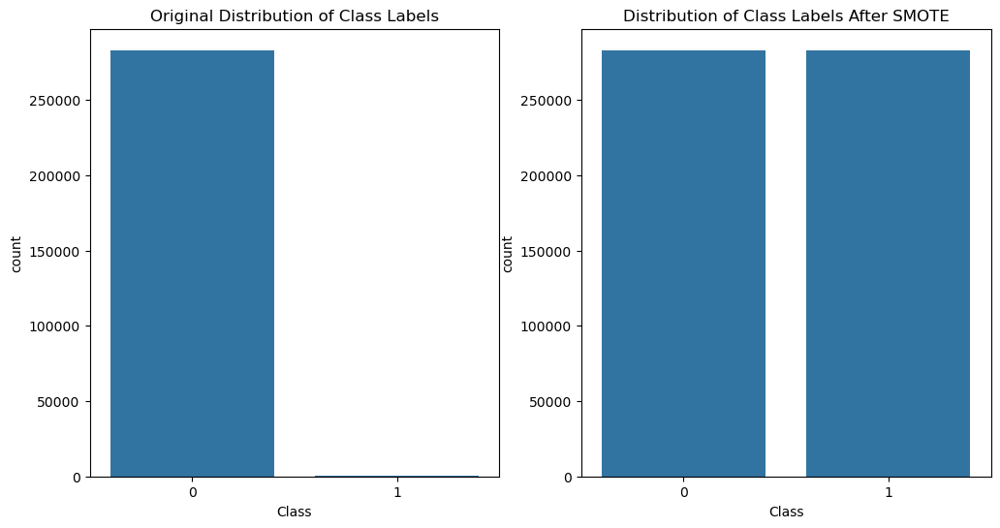

Training set size: 396554 samples
Validation set size: 84976 samples
Test set size: 84976 samples


In [4]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.impute import SimpleImputer
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

# Step 1: Load the dataset
data = pd.read_csv('creditcard.csv')

# Step 2: Data Cleaning
# Check for missing values
print("Missing values in each column:\n", data.isnull().sum())

# Drop rows with missing values (if any)
data.dropna(inplace=True)

# Check for duplicates
print("Number of duplicate rows:", data.duplicated().sum())

# Drop duplicate rows (if any)
data.drop_duplicates(inplace=True)

# Step 3: Encode Categorical Variables (if any)
# Assuming 'category_column' is a placeholder for actual categorical columns
# encoder = OneHotEncoder()
# encoded_categories = encoder.fit_transform(data[['category_column']]).toarray()
# encoded_df = pd.DataFrame(encoded_categories, columns=encoder.get_feature_names_out(['category_column']))
# data = pd.concat([data, encoded_df], axis=1)
# data.drop(['category_column'], axis=1, inplace=True)

# Note: The creditcard.csv dataset used in many examples does not typically contain categorical variables

# Step 4: Normalize Numerical Features
# Standardizing numerical features
scaler = StandardScaler()
data[['Amount', 'Time']] = scaler.fit_transform(data[['Amount', 'Time']])

# Step 5: Handle Imbalanced Data
# Split data into features (X) and target (y)
X = data.drop('Class', axis=1)
y = data['Class']

# Use SMOTE to handle imbalanced data
smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X, y)

# Step 6: Split Data into Training, Validation, and Test Sets
X_train, X_temp, y_train, y_temp = train_test_split(X_resampled, y_resampled, test_size=0.3, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Optional: Visualize the distribution of the target variable before and after resampling
fig, axs = plt.subplots(1, 2, figsize=(12, 6))

sns.countplot(x=y, ax=axs[0])
axs[0].set_title('Original Distribution of Class Labels')

sns.countplot(x=y_resampled, ax=axs[1])
axs[1].set_title('Distribution of Class Labels After SMOTE')

plt.show()

print(f"Training set size: {X_train.shape[0]} samples")
print(f"Validation set size: {X_val.shape[0]} samples")
print(f"Test set size: {X_test.shape[0]} samples")

## Exploratory Data Analysis (EDA)

#### Understanding Data Distribution

   Time        V1        V2        V3        V4        V5        V6        V7  \
0   0.0 -1.359807 -0.072781  2.536347  1.378155 -0.338321  0.462388  0.239599   
1   0.0  1.191857  0.266151  0.166480  0.448154  0.060018 -0.082361 -0.078803   
2   1.0 -1.358354 -1.340163  1.773209  0.379780 -0.503198  1.800499  0.791461   
3   1.0 -0.966272 -0.185226  1.792993 -0.863291 -0.010309  1.247203  0.237609   
4   2.0 -1.158233  0.877737  1.548718  0.403034 -0.407193  0.095921  0.592941   

         V8        V9  ...       V21       V22       V23       V24       V25  \
0  0.098698  0.363787  ... -0.018307  0.277838 -0.110474  0.066928  0.128539   
1  0.085102 -0.255425  ... -0.225775 -0.638672  0.101288 -0.339846  0.167170   
2  0.247676 -1.514654  ...  0.247998  0.771679  0.909412 -0.689281 -0.327642   
3  0.377436 -1.387024  ... -0.108300  0.005274 -0.190321 -1.175575  0.647376   
4 -0.270533  0.817739  ... -0.009431  0.798278 -0.137458  0.141267 -0.206010   

        V26       V27       V28 

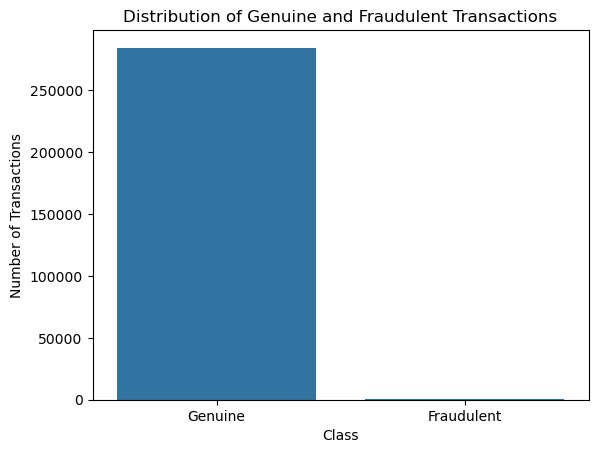

In [12]:
import pandas as pd

# Load the dataset
file_path = 'creditcard.csv'  # Replace with the path to your dataset
data = pd.read_csv(file_path)

# Check the first few rows of the dataset to understand its structure
print(data.head())

# Assuming the target column indicating fraud is named 'Class'
# 0 -> Genuine transactions
# 1 -> Fraudulent transactions
class_counts = data['Class'].value_counts()

# Display the counts of each class
print("Class distribution:")
print(class_counts)

# Optional: Visualize the class distribution using a bar plot
import matplotlib.pyplot as plt
import seaborn as sns

sns.countplot(x='Class', data=data)
plt.title('Distribution of Genuine and Fraudulent Transactions')
plt.xlabel('Class')
plt.ylabel('Number of Transactions')
plt.xticks(ticks=[0, 1], labels=['Genuine', 'Fraudulent'])
plt.show()

## The Dataset is highly unbalanced 

#### Visualizing Data

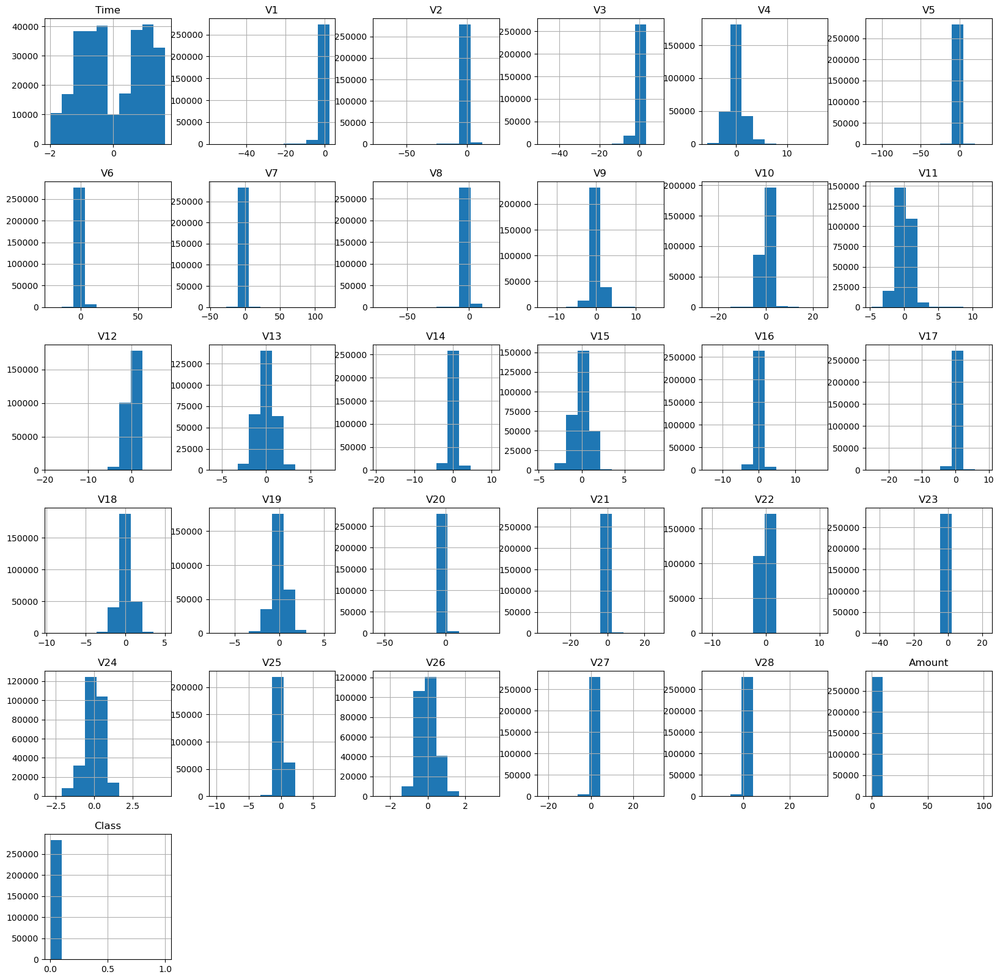

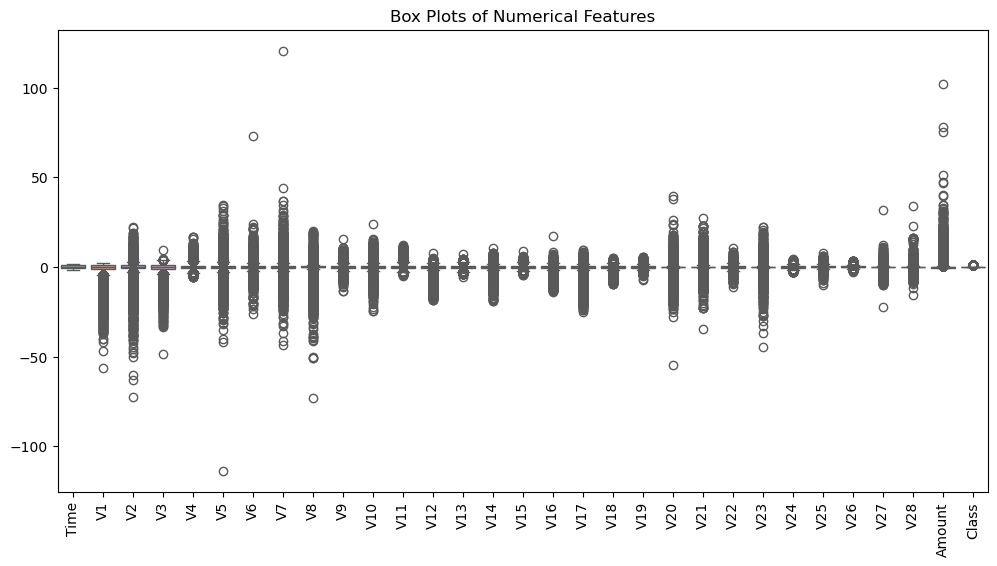

In [6]:
# Histograms for numerical features
data.hist(figsize=(20, 20))
plt.show()

# Box plots for numerical features
plt.figure(figsize=(12, 6))
sns.boxplot(data=data, palette="Set2")
plt.xticks(rotation=90)
plt.title('Box Plots of Numerical Features')
plt.show()

#### Identifying Patterns and Relationships

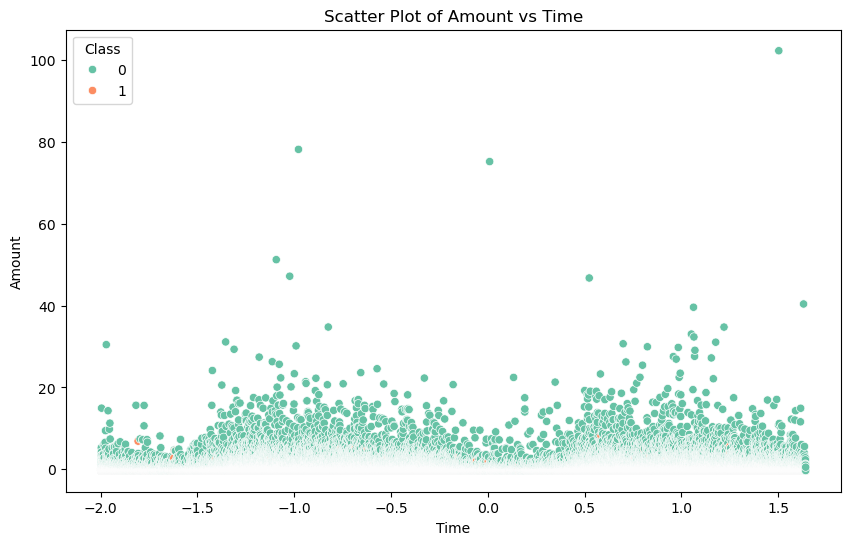

In [9]:
# Pair plot
sns.pairplot(data.sample(1000), hue='Class', palette="Set2")
plt.show()

# Scatter plot between 'Amount' and 'Time'
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Time', y='Amount', hue='Class', data=data, palette="Set2")
plt.title('Scatter Plot of Amount vs Time')
plt.show()

#### Detecting Outliers and Anomalies

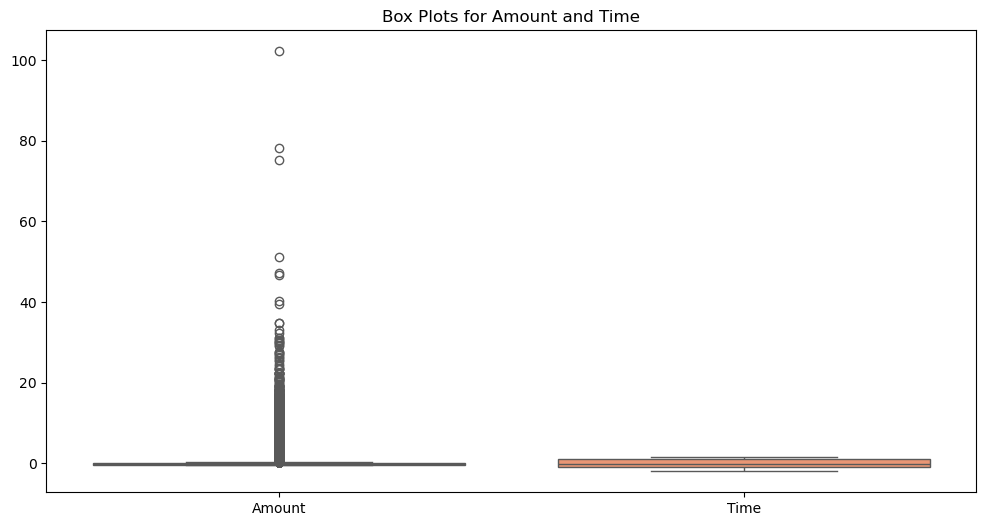

In [10]:
# Box plots for identifying outliers
plt.figure(figsize=(12, 6))
sns.boxplot(data=data[['Amount', 'Time']], palette="Set2")
plt.title('Box Plots for Amount and Time')
plt.show()

#### Feature Correlation Analysis

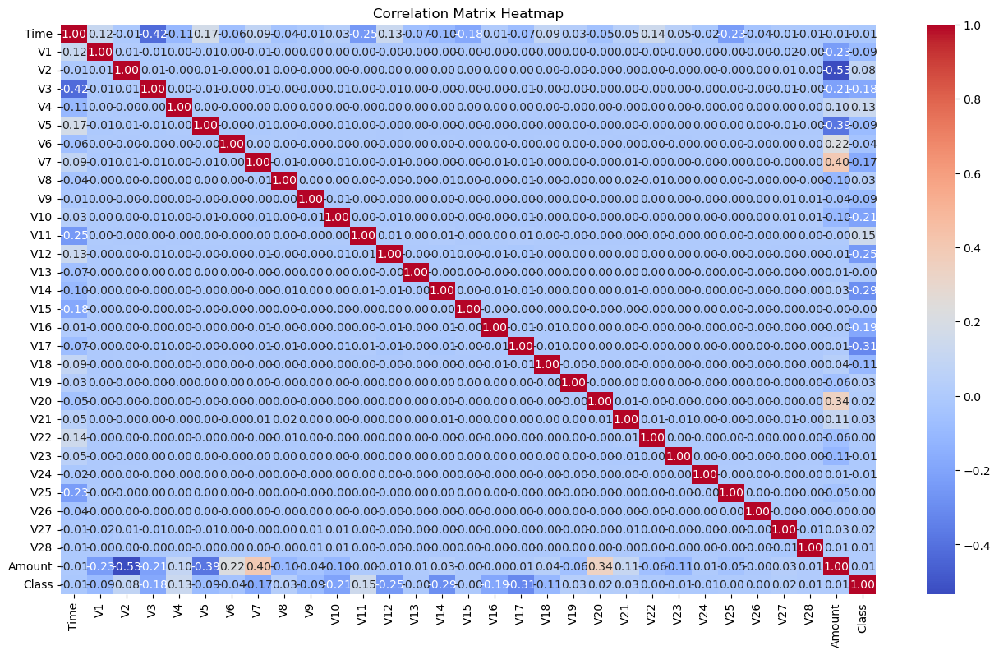

In [11]:
# Correlation matrix
correlation_matrix = data.corr()

# Heatmap
plt.figure(figsize=(16, 9))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm')
plt.title('Correlation Matrix Heatmap')
plt.show()

In [14]:
# Separate fraudulent and genuine transactions
fraudulent_transactions = data[data['Class'] == 1]
genuine_transactions = data[data['Class'] == 0]

In [15]:
# Display the number of fraudulent and genuine transactions
print(f"Number of fraudulent transactions: {len(fraudulent_transactions)}")
print(f"Number of genuine transactions: {len(genuine_transactions)}")

Number of fraudulent transactions: 492
Number of genuine transactions: 284315


In [16]:
# Save the separated datasets to CSV files for further analysis
fraudulent_transactions.to_csv('fraudulent_transactions.csv', index=False)
genuine_transactions.to_csv('genuine_transactions.csv', index=False)

In [17]:

# Statistical summary of fraudulent transactions
print("Summary statistics for fraudulent transactions:")
print(fraudulent_transactions.describe())

# Statistical summary of genuine transactions
print("Summary statistics for genuine transactions:")
print(genuine_transactions.describe())

Summary statistics for fraudulent transactions:
                Time          V1          V2          V3          V4  \
count     492.000000  492.000000  492.000000  492.000000  492.000000   
mean    80746.806911   -4.771948    3.623778   -7.033281    4.542029   
std     47835.365138    6.783687    4.291216    7.110937    2.873318   
min       406.000000  -30.552380   -8.402154  -31.103685   -1.313275   
25%     41241.500000   -6.036063    1.188226   -8.643489    2.373050   
50%     75568.500000   -2.342497    2.717869   -5.075257    4.177147   
75%    128483.000000   -0.419200    4.971257   -2.276185    6.348729   
max    170348.000000    2.132386   22.057729    2.250210   12.114672   

               V5          V6          V7          V8          V9  ...  \
count  492.000000  492.000000  492.000000  492.000000  492.000000  ...   
mean    -3.151225   -1.397737   -5.568731    0.570636   -2.581123  ...   
std      5.372468    1.858124    7.206773    6.797831    2.500896  ...   
min    

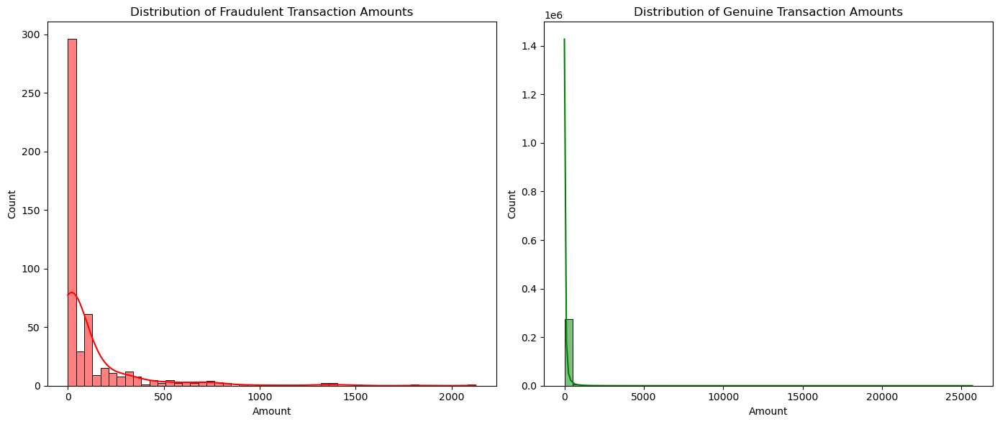

In [18]:
# Visualize distributions
import matplotlib.pyplot as plt
import seaborn as sns

# Distribution of transaction amounts
plt.figure(figsize=(14, 6))
plt.subplot(1, 2, 1)
sns.histplot(fraudulent_transactions['Amount'], bins=50, kde=True, color='red')
plt.title('Distribution of Fraudulent Transaction Amounts')

plt.subplot(1, 2, 2)
sns.histplot(genuine_transactions['Amount'], bins=50, kde=True, color='green')
plt.title('Distribution of Genuine Transaction Amounts')

plt.tight_layout()
plt.show()

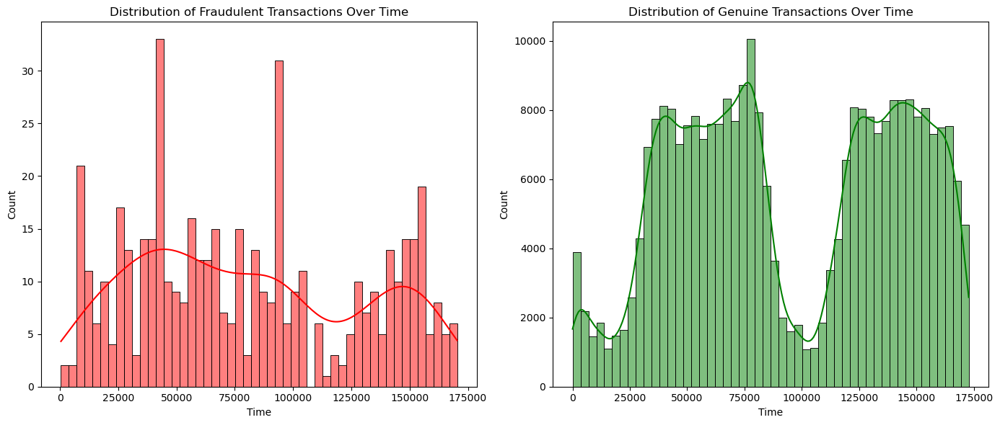

In [19]:
# Time-based analysis
plt.figure(figsize=(14, 6))
plt.subplot(1, 2, 1)
sns.histplot(fraudulent_transactions['Time'], bins=50, kde=True, color='red')
plt.title('Distribution of Fraudulent Transactions Over Time')

plt.subplot(1, 2, 2)
sns.histplot(genuine_transactions['Time'], bins=50, kde=True, color='green')
plt.title('Distribution of Genuine Transactions Over Time')

plt.tight_layout()
plt.show()

## Feature Engineering 

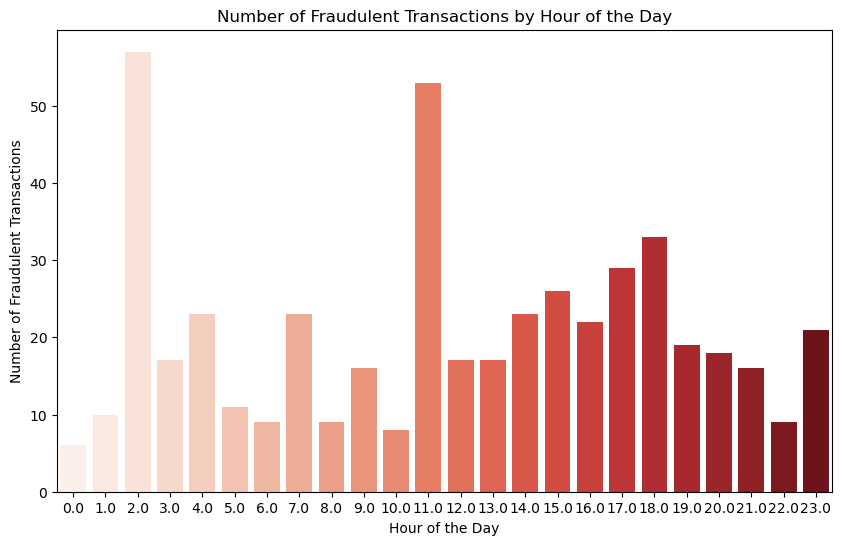

In [20]:
# Time of the Day Analysis

# Extract the hour of the day from the 'Time' feature
data['Hour'] = data['Time'].apply(lambda x: (x // 3600) % 24)

# Separate the fraudulent transactions
fraudulent_transactions = data[data['Class'] == 1]

# Group by hour and count the number of fraudulent transactions
fraud_by_hour = fraudulent_transactions.groupby('Hour').size()

# Plot the distribution of fraudulent transactions over hours
plt.figure(figsize=(10, 6))
sns.barplot(x=fraud_by_hour.index, y=fraud_by_hour.values, palette="Reds")
plt.title('Number of Fraudulent Transactions by Hour of the Day')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Fraudulent Transactions')
plt.xticks(range(24))
plt.show()

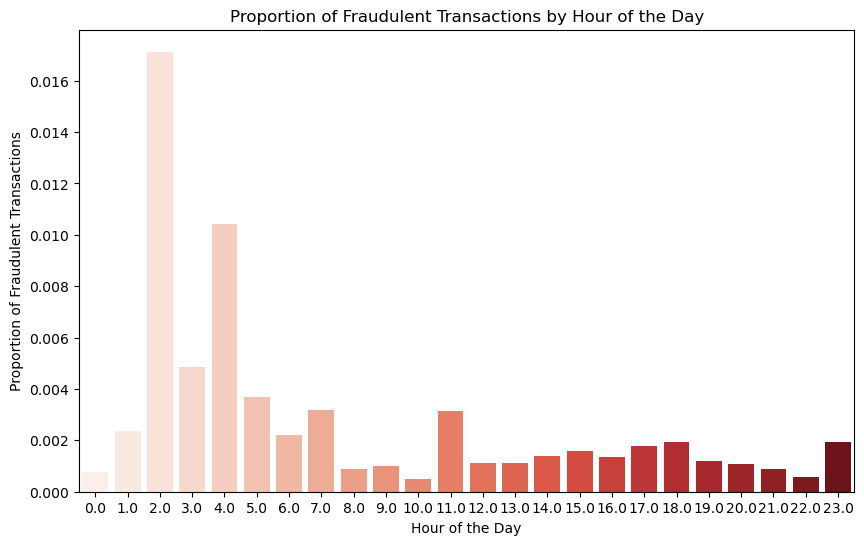

In [21]:
# Group by hour and count the number of all transactions
total_by_hour = data.groupby('Hour').size()

# Calculate the proportion of fraudulent transactions per hour
fraud_proportion_by_hour = fraud_by_hour / total_by_hour

# Plot the proportion of fraudulent transactions over hours
plt.figure(figsize=(10, 6))
sns.barplot(x=fraud_proportion_by_hour.index, y=fraud_proportion_by_hour.values, palette="Reds")
plt.title('Proportion of Fraudulent Transactions by Hour of the Day')
plt.xlabel('Hour of the Day')
plt.ylabel('Proportion of Fraudulent Transactions')
plt.xticks(range(24))
plt.show()

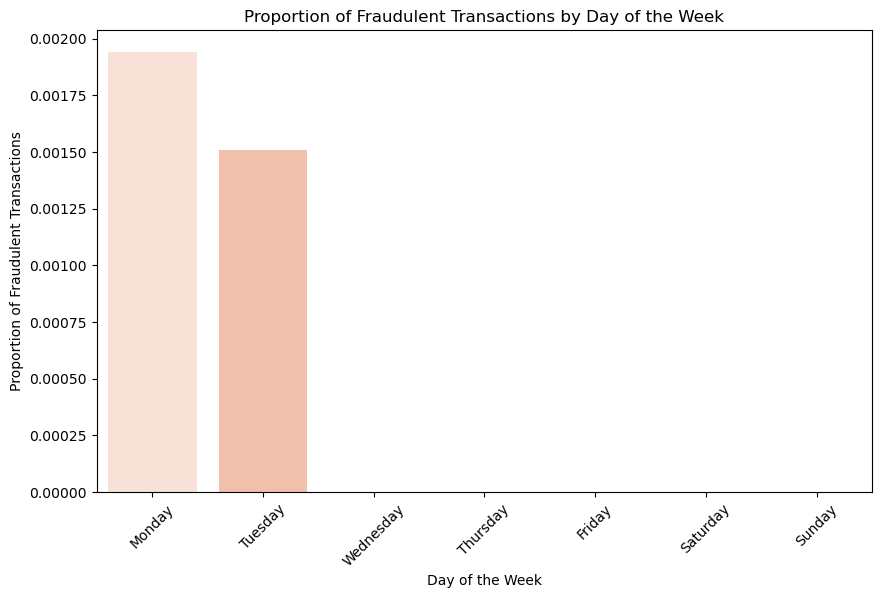

In [22]:
# Extract the day of the week from the 'Time' feature (assuming 'Time' is in seconds since the start of the dataset collection)
data['Day'] = data['Time'].apply(lambda x: (x // (3600 * 24)) % 7)

# Map numeric days to actual day names for better readability
day_mapping = {0: 'Monday', 1: 'Tuesday', 2: 'Wednesday', 3: 'Thursday', 4: 'Friday', 5: 'Saturday', 6: 'Sunday'}
data['Day'] = data['Day'].map(day_mapping)

# Separate the fraudulent transactions
fraudulent_transactions = data[data['Class'] == 1]

# Group by day and count the number of fraudulent transactions
fraud_by_day = fraudulent_transactions.groupby('Day').size()

# Group by day and count the number of all transactions
total_by_day = data.groupby('Day').size()

# Calculate the proportion of fraudulent transactions per day
fraud_proportion_by_day = fraud_by_day / total_by_day

# Sort the proportions by day of the week
ordered_days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
fraud_proportion_by_day = fraud_proportion_by_day.reindex(ordered_days)

# Plot the proportion of fraudulent transactions over days
plt.figure(figsize=(10, 6))
sns.barplot(x=fraud_proportion_by_day.index, y=fraud_proportion_by_day.values, palette="Reds")
plt.title('Proportion of Fraudulent Transactions by Day of the Week')
plt.xlabel('Day of the Week')
plt.ylabel('Proportion of Fraudulent Transactions')
plt.xticks(rotation=45)
plt.show()

   Time        V1        V2        V3        V4        V5        V6        V7  \
0   0.0 -1.359807 -0.072781  2.536347  1.378155 -0.338321  0.462388  0.239599   
1   0.0  1.191857  0.266151  0.166480  0.448154  0.060018 -0.082361 -0.078803   
2   1.0 -1.358354 -1.340163  1.773209  0.379780 -0.503198  1.800499  0.791461   
3   1.0 -0.966272 -0.185226  1.792993 -0.863291 -0.010309  1.247203  0.237609   
4   2.0 -1.158233  0.877737  1.548718  0.403034 -0.407193  0.095921  0.592941   

         V8        V9  ...       V28  Amount  Class  Hour  Day  Is_Odd_Time  \
0  0.098698  0.363787  ... -0.021053  149.62      0   0.0  0.0         True   
1  0.085102 -0.255425  ...  0.014724    2.69      0   0.0  0.0         True   
2  0.247676 -1.514654  ... -0.059752  378.66      0   0.0  0.0         True   
3  0.377436 -1.387024  ...  0.061458  123.50      0   0.0  0.0         True   
4 -0.270533  0.817739  ...  0.215153   69.99      0   0.0  0.0         True   

   Day_Since_Start  Daily_Spending  Ex

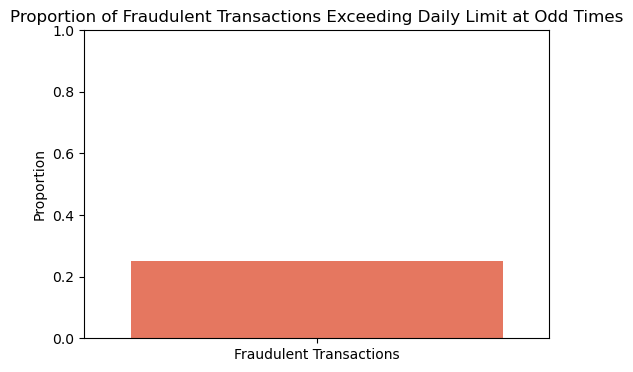

In [31]:
# Ensure the dataset has the required columns
required_columns = ["Time", "Amount", "Class"]

if not all(column in data.columns for column in required_columns):
    raise ValueError("Dataset does not contain all required columns")

# Time-Based Features
data['Hour'] = data['Time'].apply(lambda x: (x // 3600) % 24)
data['Day'] = data['Time'].apply(lambda x: (x // (3600 * 24)) % 7)

# Define odd times of the day (e.g., 12 AM - 6 AM)
def is_odd_time(hour):
    return 0 <= hour < 6

data['Is_Odd_Time'] = data['Hour'].apply(is_odd_time)

# Calculate daily spending for each transaction
data['Day_Since_Start'] = data['Time'].apply(lambda x: x // (3600 * 24))
data['Daily_Spending'] = data.groupby(['Day_Since_Start'])['Amount'].transform('sum')

# Define a daily spending limit (this should be adjusted based on domain knowledge or data insights)
DAILY_SPENDING_LIMIT = 500  # Example limit, adjust as necessary

# Flag transactions that exceed the daily spending limit
data['Exceeds_Daily_Limit'] = data['Daily_Spending'] > DAILY_SPENDING_LIMIT

# Combine features to flag transactions that exceed the daily limit and occur at odd times
data['Odd_Time_Exceeds_Limit'] = data['Is_Odd_Time'] & data['Exceeds_Daily_Limit']

# Check the first few rows to see the new features
print(data.head())

# Analyze the proportion of fraudulent transactions that exceed the daily limit at odd times
fraudulent_transactions = data[data['Class'] == 1]
fraud_odd_time_exceeds_limit = fraudulent_transactions['Odd_Time_Exceeds_Limit'].mean()

print(f"Proportion of fraudulent transactions exceeding daily limit at odd times: {fraud_odd_time_exceeds_limit:.2%}")

# Visualize the proportion of such transactions
plt.figure(figsize=(6, 4))
sns.barplot(x=['Fraudulent Transactions'], y=[fraud_odd_time_exceeds_limit], palette="Reds")
plt.title('Proportion of Fraudulent Transactions Exceeding Daily Limit at Odd Times')
plt.ylabel('Proportion')
plt.ylim(0, 1)
plt.show()

In [32]:
# Aggregated Features
data['Day_Since_Start'] = data['Time'].apply(lambda x: x // (3600 * 24))
data['Daily_Spending'] = data.groupby(['Day_Since_Start'])['Amount'].transform('sum')
data['Week_Since_Start'] = data['Time'].apply(lambda x: x // (3600 * 24 * 7))
data['Weekly_Spending'] = data.groupby(['Week_Since_Start'])['Amount'].transform('sum')
data['Avg_Daily_Spending'] = data.groupby(['Day_Since_Start'])['Amount'].transform('mean')

# Behavioral Features
DAILY_SPENDING_LIMIT = 500  # Example limit, adjust as necessary
data['Exceeds_Daily_Limit'] = data['Daily_Spending'] > DAILY_SPENDING_LIMIT
data['Time_Since_Last_Transaction'] = data.groupby(['Day_Since_Start'])['Time'].diff()
data['Change_in_Amount'] = data.groupby(['Day_Since_Start'])['Amount'].diff()

# Interaction Features
data['Amount_Hour_Interaction'] = data['Amount'] * data['Hour']
data['Daily_Spending_Odd_Time_Interaction'] = data['Daily_Spending'] * data['Is_Odd_Time']
data['Change_Amount_Time_Interaction'] = data['Change_in_Amount'] * data['Time_Since_Last_Transaction']

# Rolling statistics for transaction amounts over a window of 3 days
data['Rolling_Mean_Amount_3D'] = data.groupby(['Day_Since_Start'])['Amount'].transform(lambda x: x.rolling(window=3).mean())
data['Rolling_Std_Amount_3D'] = data.groupby(['Day_Since_Start'])['Amount'].transform(lambda x: x.rolling(window=3).std())

# Check the first few rows to see the new features
print(data.head())

   Time        V1        V2        V3        V4        V5        V6        V7  \
0   0.0 -1.359807 -0.072781  2.536347  1.378155 -0.338321  0.462388  0.239599   
1   0.0  1.191857  0.266151  0.166480  0.448154  0.060018 -0.082361 -0.078803   
2   1.0 -1.358354 -1.340163  1.773209  0.379780 -0.503198  1.800499  0.791461   
3   1.0 -0.966272 -0.185226  1.792993 -0.863291 -0.010309  1.247203  0.237609   
4   2.0 -1.158233  0.877737  1.548718  0.403034 -0.407193  0.095921  0.592941   

         V8        V9  ...  Week_Since_Start  Weekly_Spending  \
0  0.098698  0.363787  ...               0.0      25162590.01   
1  0.085102 -0.255425  ...               0.0      25162590.01   
2  0.247676 -1.514654  ...               0.0      25162590.01   
3  0.377436 -1.387024  ...               0.0      25162590.01   
4 -0.270533  0.817739  ...               0.0      25162590.01   

   Avg_Daily_Spending  Time_Since_Last_Transaction  Change_in_Amount  \
0           90.436748                          NaN

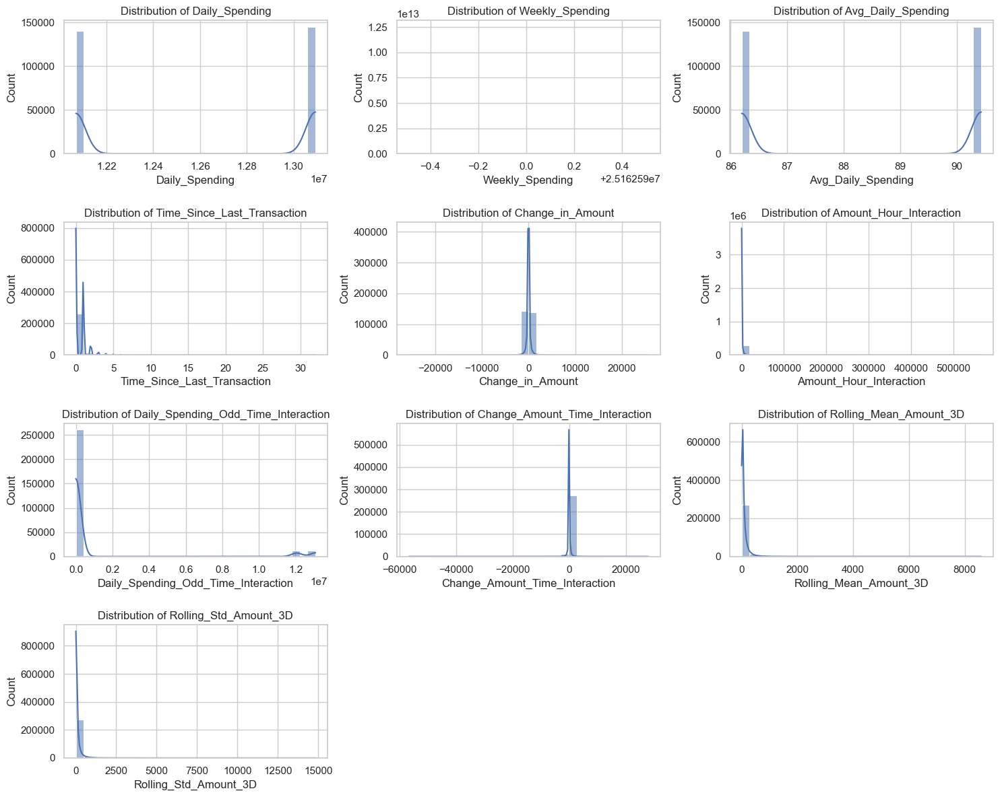

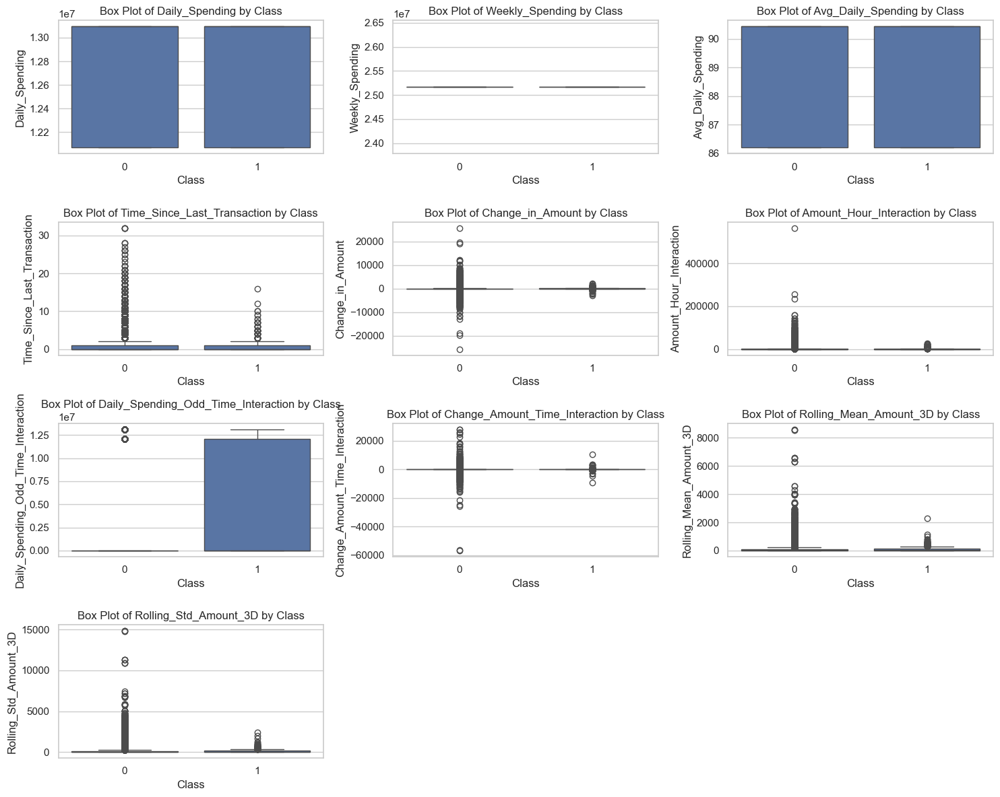

In [33]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the style
sns.set(style="whitegrid")

# List of new features
new_features = ['Daily_Spending', 'Weekly_Spending', 'Avg_Daily_Spending', 
                'Time_Since_Last_Transaction', 'Change_in_Amount', 
                'Amount_Hour_Interaction', 'Daily_Spending_Odd_Time_Interaction', 
                'Change_Amount_Time_Interaction', 'Rolling_Mean_Amount_3D', 
                'Rolling_Std_Amount_3D']

# Plot histograms of new features
plt.figure(figsize=(15, 12))
for i, feature in enumerate(new_features):
    plt.subplot(4, 3, i + 1)
    sns.histplot(data[feature].dropna(), kde=True, bins=30)
    plt.title(f'Distribution of {feature}')

plt.tight_layout()
plt.show()

# Plot box plots of new features
plt.figure(figsize=(15, 12))
for i, feature in enumerate(new_features):
    plt.subplot(4, 3, i + 1)
    sns.boxplot(x='Class', y=feature, data=data)
    plt.title(f'Box Plot of {feature} by Class')

plt.tight_layout()
plt.show()

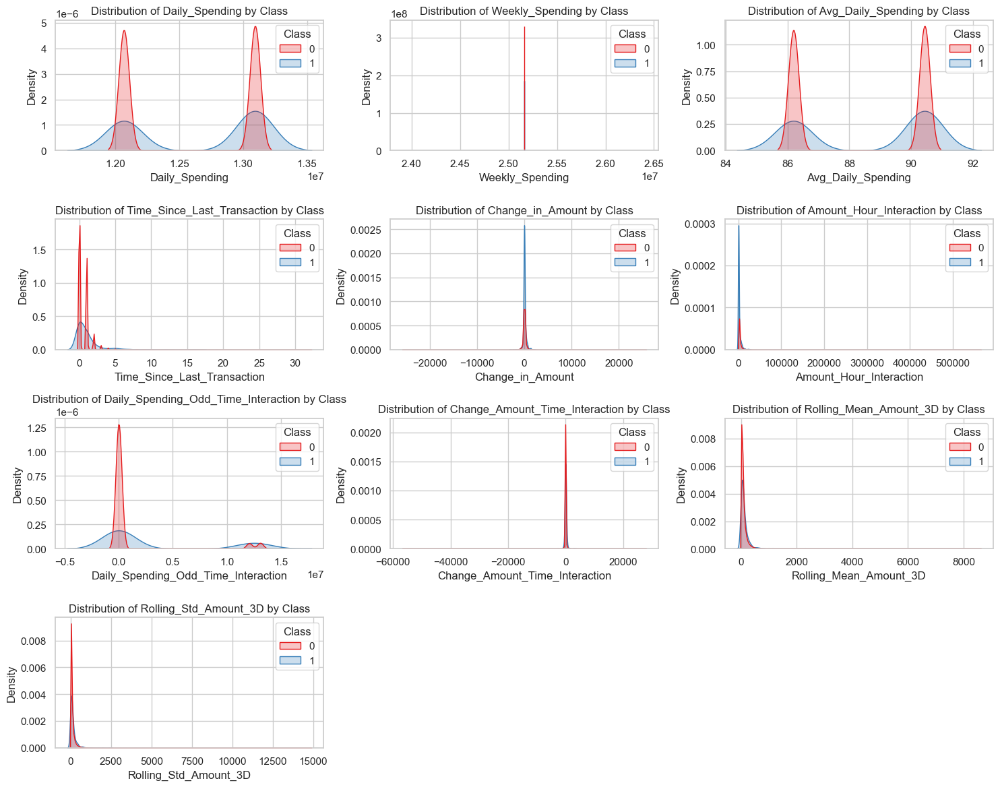

In [34]:
# Plot the relationship between new features and fraud
plt.figure(figsize=(15, 12))
for i, feature in enumerate(new_features):
    plt.subplot(4, 3, i + 1)
    sns.kdeplot(data=data, x=feature, hue="Class", fill=True, common_norm=False, palette="Set1")
    plt.title(f'Distribution of {feature} by Class')

plt.tight_layout()
plt.show()

## Combining Random Under Sampling and SMOTEENN for Enhanced Class Balancing

In [36]:
from imblearn.combine import SMOTEENN
from imblearn.under_sampling import RandomUnderSampler
from collections import Counter

# Separate features and target
X = data.drop(['Class'], axis=1)
y = data['Class']

# Apply undersampling
rus = RandomUnderSampler(sampling_strategy=0.5, random_state=42)
X_res, y_res = rus.fit_resample(X, y)

print('Resampled dataset shape:', Counter(y_res))

# Apply oversampling using SMOTE on the undersampled dataset
smote_enn = SMOTEENN(sampling_strategy='auto', random_state=42)
X_resampled, y_resampled = smote_enn.fit_resample(X_res, y_res)

print('Resampled dataset shape after SMOTEENN:', Counter(y_resampled))

# Check the first few rows to see the new dataset
print(X_resampled.head())
print(y_resampled.head())

Resampled dataset shape: Counter({0: 984, 1: 492})
Resampled dataset shape after SMOTEENN: Counter({1: 556, 0: 426})
      Time        V1        V2        V3        V4        V5        V6  \
0  50554.0 -0.798672  1.185093  0.904547  0.694584  0.219041 -0.319295   
1  39411.0  1.321979 -0.575195  0.395503 -0.551813 -1.172345 -1.036152   
2  42330.0 -0.897612 -0.639783  1.718046 -1.640556  0.042526 -0.738404   
3  81853.0  1.301798 -1.170032 -0.244466 -1.515675 -0.870002 -0.295976   
4  56703.0  1.197048 -0.516517  0.445305 -0.260484 -0.645504  0.126351   

         V7        V8        V9  ...  Week_Since_Start  Weekly_Spending  \
0  0.495236  0.139269 -0.760214  ...               0.0      25162590.01   
1 -0.417696 -0.228770 -0.819610  ...               0.0      25162590.01   
2 -0.331166  0.123864 -1.415013  ...               0.0      25162590.01   
3 -0.535385 -0.100750 -2.441687  ...               0.0      25162590.01   
4 -0.509842  0.080492 -1.262008  ...               0.0      251

In [37]:
from sklearn.model_selection import train_test_split

# Separate features and target
X = data.drop(['Class'], axis=1)
y = data['Class']

# Step 1: Split the dataset into training (60%) and remaining (40%) sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42, stratify=y)

# Step 2: Split the remaining set into validation (20%) and testing (20%) sets
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42, stratify=y_temp)

# Check the sizes of the splits
print("Training set size:", X_train.shape, y_train.shape)
print("Validation set size:", X_val.shape, y_val.shape)
print("Testing set size:", X_test.shape, y_test.shape)

Training set size: (170884, 47) (170884,)
Validation set size: (56961, 47) (56961,)
Testing set size: (56962, 47) (56962,)


## Models

#### Long Short-Term Memory Networks (LSTM)

Epoch 1/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 5s 1ms/step - accuracy: 0.9911 - loss: 0.0623 - val_accuracy: 0.9461 - val_loss: 0.1215
Epoch 2/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9995 - loss: 0.0031 - val_accuracy: 0.9726 - val_loss: 0.0888
Epoch 3/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9996 - loss: 0.0025 - val_accuracy: 0.9707 - val_loss: 0.0777
Epoch 4/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9996 - loss: 0.0023 - val_accuracy: 0.9893 - val_loss: 0.0484
Epoch 5/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9996 - loss: 0.0022 - val_accuracy: 0.9945 - val_loss: 0.0251
Epoch 6/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9996 - loss: 0.0024 - val_accuracy: 0.9958 - val_loss: 0.0165
Epoch 7/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9996 - loss: 0.0020 - val_accuracy: 0.9954 - val_loss: 0.0149
Epoch 8/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9996 - loss: 0.0018 - 

3561/3561 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9995 - loss: 0.0018 - val_accuracy: 0.9994 - val_loss: 0.0036
Epoch 8/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9995 - loss: 0.0017 - val_accuracy: 0.9995 - val_loss: 0.0030
Epoch 9/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9996 - loss: 0.0016 - val_accuracy: 0.9995 - val_loss: 0.0029
Epoch 10/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9996 - loss: 0.0018 - val_accuracy: 0.9995 - val_loss: 0.0029
1781/1781 ━━━━━━━━━━━━━━━━━━━━ 1s 377us/step
Fold 5 - Accuracy: 0.9995, Precision: 0.9455, Recall: 0.6933, F1 Score: 0.8000
Average Accuracy: 0.9975
Average Precision: 0.6670
Average Recall: 0.7833
Average F1 Score: 0.6605


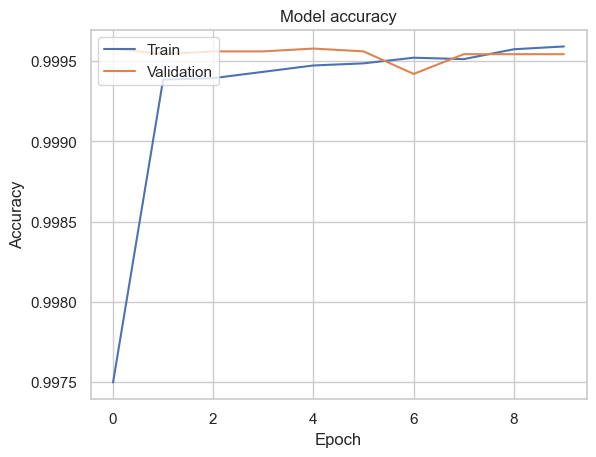

In [112]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout, GaussianNoise
import matplotlib.pyplot as plt

# Load the dataset
file_path = 'creditcard.csv'
data = pd.read_csv(file_path)

# Ensure the dataset has the required columns
required_columns = ["Time", "Amount", "Class"]
if not all(column in data.columns for column in required_columns):
    raise ValueError("Dataset does not contain all required columns")

# Time-Based Features
data['Hour'] = data['Time'].apply(lambda x: (x // 3600) % 24)
data['Day'] = data['Time'].apply(lambda x: (x // (3600 * 24)) % 7)

# Define odd times of the day (12 AM - 6 AM)
def is_odd_time(hour):
    return 0 <= hour < 6

data['Is_Odd_Time'] = data['Hour'].apply(is_odd_time)

# Aggregated Features
data['Day_Since_Start'] = data['Time'].apply(lambda x: x // (3600 * 24))
data['Daily_Spending'] = data.groupby(['Day_Since_Start'])['Amount'].transform('sum')
data['Week_Since_Start'] = data['Time'].apply(lambda x: x // (3600 * 24 * 7))
data['Weekly_Spending'] = data.groupby(['Week_Since_Start'])['Amount'].transform('sum')
data['Avg_Daily_Spending'] = data.groupby(['Day_Since_Start'])['Amount'].transform('mean')

# Behavioral Features
DAILY_SPENDING_LIMIT = 500  # Example limit, adjust as necessary
data['Exceeds_Daily_Limit'] = data['Daily_Spending'] > DAILY_SPENDING_LIMIT
data['Time_Since_Last_Transaction'] = data.groupby(['Day_Since_Start'])['Time'].diff()
data['Change_in_Amount'] = data.groupby(['Day_Since_Start'])['Amount'].diff()

# Interaction Features
data['Amount_Hour_Interaction'] = data['Amount'] * data['Hour']
data['Daily_Spending_Odd_Time_Interaction'] = data['Daily_Spending'] * data['Is_Odd_Time']
data['Change_Amount_Time_Interaction'] = data['Change_in_Amount'] * data['Time_Since_Last_Transaction']

# Rolling statistics for transaction amounts over a window of 3 days
data['Rolling_Mean_Amount_3D'] = data.groupby(['Day_Since_Start'])['Amount'].transform(lambda x: x.rolling(window=3).mean())
data['Rolling_Std_Amount_3D'] = data.groupby(['Day_Since_Start'])['Amount'].transform(lambda x: x.rolling(window=3).std())

# Fill NaN values generated by diff() and rolling() methods
data.fillna(0, inplace=True)

# Separate features and target
X = data.drop(['Class'], axis=1)
y = data['Class']

# Scale the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Reshape data for LSTM (samples, timesteps, features)
X_scaled = X_scaled.reshape(X_scaled.shape[0], 1, X_scaled.shape[1])

# Define the LSTM model function
def create_model():
    model = Sequential()
    model.add(GaussianNoise(0.1, input_shape=(X_scaled.shape[1], X_scaled.shape[2])))
    model.add(LSTM(64, return_sequences=True))
    model.add(Dropout(0.2))
    model.add(LSTM(32, return_sequences=False))
    model.add(Dropout(0.2))
    model.add(Dense(1, activation='sigmoid'))
    model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
    return model

# Perform K-Fold Cross-Validation
kf = KFold(n_splits=5)
fold_no = 1
accuracies = []
precisions = []
recalls = []
f1_scores = []

for train_index, val_index in kf.split(X_scaled):
    X_train, X_val = X_scaled[train_index], X_scaled[val_index]
    y_train, y_val = y[train_index], y[val_index]
    
    model = create_model()
    history = model.fit(X_train, y_train, epochs=10, batch_size=64, validation_data=(X_val, y_val), verbose=1)
    
    # Predictions
    y_val_pred = (model.predict(X_val) > 0.5).astype("int32")
    
    # Metrics
    accuracy = accuracy_score(y_val, y_val_pred)
    precision = precision_score(y_val, y_val_pred)
    recall = recall_score(y_val, y_val_pred)
    f1 = f1_score(y_val, y_val_pred)
    
    print(f'Fold {fold_no} - Accuracy: {accuracy:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1 Score: {f1:.4f}')
    
    accuracies.append(accuracy)
    precisions.append(precision)
    recalls.append(recall)
    f1_scores.append(f1)
    
    fold_no += 1

print(f'Average Accuracy: {np.mean(accuracies):.4f}')
print(f'Average Precision: {np.mean(precisions):.4f}')
print(f'Average Recall: {np.mean(recalls):.4f}')
print(f'Average F1 Score: {np.mean(f1_scores):.4f}')

# Plot the training & validation accuracy values
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

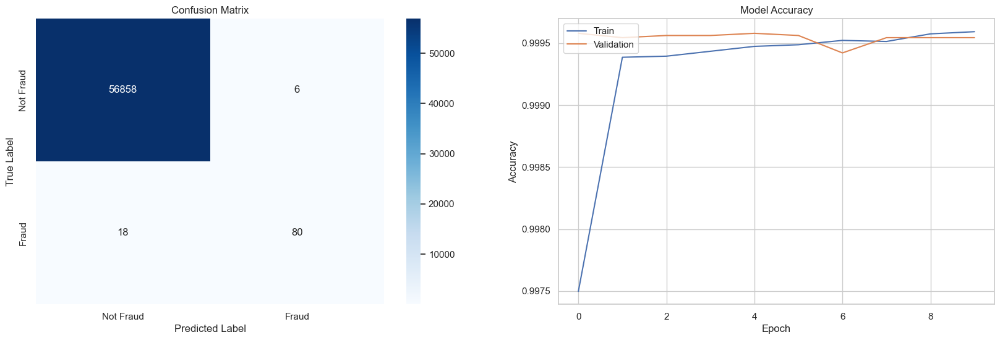

In [113]:
fig, ax = plt.subplots(1, 2, figsize=(20, 6))

# Plot confusion matrix
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Not Fraud', 'Fraud'], yticklabels=['Not Fraud', 'Fraud'], ax=ax[0])
ax[0].set_xlabel('Predicted Label')
ax[0].set_ylabel('True Label')
ax[0].set_title('Confusion Matrix')

# Plot training & validation accuracy
ax[1].plot(history.history['accuracy'], label='Train')
ax[1].plot(history.history['val_accuracy'], label='Validation')
ax[1].set_title('Model Accuracy')
ax[1].set_ylabel('Accuracy')
ax[1].set_xlabel('Epoch')
ax[1].legend(loc='upper left')

plt.show()

#### Autoencoder

In [100]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, GaussianNoise
from tensorflow.keras.optimizers import Adam
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
file_path = 'creditcard.csv'  
data = pd.read_csv(file_path)

# Ensure the dataset has the required columns
required_columns = ["Time", "Amount", "Class"]
if not all(column in data.columns for column in required_columns):
    raise ValueError("Dataset does not contain all required columns")

# Time-Based Features
data['Hour'] = data['Time'].apply(lambda x: (x // 3600) % 24)
data['Day'] = data['Time'].apply(lambda x: (x // (3600 * 24)) % 7)

# Define odd times of the day (12 AM - 6 AM)
def is_odd_time(hour):
    return 0 <= hour < 6

data['Is_Odd_Time'] = data['Hour'].apply(is_odd_time)

# Aggregated Features
data['Day_Since_Start'] = data['Time'].apply(lambda x: x // (3600 * 24))
data['Daily_Spending'] = data.groupby(['Day_Since_Start'])['Amount'].transform('sum')
data['Week_Since_Start'] = data['Time'].apply(lambda x: x // (3600 * 24 * 7))
data['Weekly_Spending'] = data.groupby(['Week_Since_Start'])['Amount'].transform('sum')
data['Avg_Daily_Spending'] = data.groupby(['Day_Since_Start'])['Amount'].transform('mean')

# Behavioral Features
DAILY_SPENDING_LIMIT = 500  # Example limit
data['Exceeds_Daily_Limit'] = data['Daily_Spending'] > DAILY_SPENDING_LIMIT
data['Time_Since_Last_Transaction'] = data.groupby(['Day_Since_Start'])['Time'].diff()
data['Change_in_Amount'] = data.groupby(['Day_Since_Start'])['Amount'].diff()

# Interaction Features
data['Amount_Hour_Interaction'] = data['Amount'] * data['Hour']
data['Daily_Spending_Odd_Time_Interaction'] = data['Daily_Spending'] * data['Is_Odd_Time']
data['Change_Amount_Time_Interaction'] = data['Change_in_Amount'] * data['Time_Since_Last_Transaction']

# Rolling statistics for transaction amounts over a window of 3 days
data['Rolling_Mean_Amount_3D'] = data.groupby(['Day_Since_Start'])['Amount'].transform(lambda x: x.rolling(window=3).mean())
data['Rolling_Std_Amount_3D'] = data.groupby(['Day_Since_Start'])['Amount'].transform(lambda x: x.rolling(window=3).std())

# Fill NaN values generated by diff() and rolling() methods
data.fillna(0, inplace=True)

# Separate features and target
X = data.drop(['Class'], axis=1)
y = data['Class']

# Scale the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Define the autoencoder architecture
input_dim = X_scaled.shape[1]
encoding_dim = 14  # Number of neurons in the bottleneck layer

def build_autoencoder(input_dim, encoding_dim):
    # Encoder
    input_layer = Input(shape=(input_dim,))
    noise_layer = GaussianNoise(0.1)(input_layer)  # Add Gaussian noise
    encoder = Dense(encoding_dim, activation="relu")(noise_layer)
    encoder = Dense(int(encoding_dim / 2), activation="relu")(encoder)
    encoder = Dense(int(encoding_dim / 4), activation="relu")(encoder)

    # Decoder
    decoder = Dense(int(encoding_dim / 2), activation="relu")(encoder)
    decoder = Dense(encoding_dim, activation="relu")(decoder)
    decoder = Dense(input_dim, activation="sigmoid")(decoder)

    # Autoencoder
    autoencoder = Model(inputs=input_layer, outputs=decoder)
    autoencoder.compile(optimizer=Adam(), loss='mean_squared_error')
    
    return autoencoder

# Cross-validation
kf = KFold(n_splits=5)
cv_scores = []

for train_index, val_index in kf.split(X_scaled):
    X_train, X_val = X_scaled[train_index], X_scaled[val_index]
    y_train, y_val = y[train_index], y[val_index]
    
    autoencoder = build_autoencoder(input_dim, encoding_dim)
    
    history = autoencoder.fit(X_train, X_train,
                              epochs=50,
                              batch_size=256,
                              shuffle=True,
                              validation_data=(X_val, X_val),
                              verbose=1)
    
    # Use the trained autoencoder to reconstruct the validation data
    X_val_pred = autoencoder.predict(X_val)
    
    # Calculate the mean squared error for each transaction
    mse = np.mean(np.power(X_val - X_val_pred, 2), axis=1)
    
    # Use a threshold to classify transactions as fraudulent or not
    threshold = np.percentile(mse, 95)
    y_pred = mse > threshold
    
    # Calculate and print the performance metrics
    conf_matrix = confusion_matrix(y_val, y_pred)
    accuracy = accuracy_score(y_val, y_pred)
    precision = precision_score(y_val, y_pred)
    recall = recall_score(y_val, y_pred)
    
    print("Confusion Matrix:")
    print(conf_matrix)
    print(f"Accuracy: {accuracy}")
    print(f"Precision: {precision}")
    print(f"Recall: {recall}")
    
    cv_scores.append((accuracy, precision, recall))

# Average the cross-validation scores
cv_scores = np.array(cv_scores)
print("Average CV Scores:")
print(f"Accuracy: {cv_scores[:, 0].mean()}")
print(f"Precision: {cv_scores[:, 1].mean()}")
print(f"Recall: {cv_scores[:, 2].mean()}")

Epoch 1/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 701us/step - loss: 0.9465 - val_loss: 1.0651
Epoch 2/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 641us/step - loss: 0.7978 - val_loss: 1.0465
Epoch 3/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 637us/step - loss: 0.7796 - val_loss: 1.0250
Epoch 4/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 631us/step - loss: 0.7685 - val_loss: 1.0318
Epoch 5/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 650us/step - loss: 0.7485 - val_loss: 1.0304
Epoch 6/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 669us/step - loss: 0.7612 - val_loss: 1.0324
Epoch 7/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 656us/step - loss: 0.7494 - val_loss: 1.0275
Epoch 8/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 665us/step - loss: 0.7584 - val_loss: 1.0316
Epoch 9/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 638us/step - loss: 0.7532 - val_loss: 1.0245
Epoch 10/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 646us/step - loss: 0.7368 - val_loss: 1.0366
Epoch 11/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 668us/step - loss: 0.7638 - val_loss: 1.0398
Epoch 12/50
891/891 ━━━━━━━━━━

891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 645us/step - loss: 0.8290 - val_loss: 0.6764
Epoch 17/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 655us/step - loss: 0.8214 - val_loss: 0.6759
Epoch 18/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 644us/step - loss: 0.8260 - val_loss: 0.6753
Epoch 19/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 636us/step - loss: 0.8255 - val_loss: 0.6757
Epoch 20/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 628us/step - loss: 0.8155 - val_loss: 0.6744
Epoch 21/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 644us/step - loss: 0.8257 - val_loss: 0.6747
Epoch 22/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 627us/step - loss: 0.8285 - val_loss: 0.6737
Epoch 23/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 660us/step - loss: 0.8155 - val_loss: 0.6735
Epoch 24/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 641us/step - loss: 0.8230 - val_loss: 0.6734
Epoch 25/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 655us/step - loss: 0.8336 - val_loss: 0.6732
Epoch 26/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 640us/step - loss: 0.8105 - val_loss: 0.6718
Epoch 27/50
891/891 ━━━━━━━━━━━━━

891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 643us/step - loss: 0.7366 - val_loss: 0.9284
Epoch 32/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 650us/step - loss: 0.7558 - val_loss: 0.9267
Epoch 33/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 650us/step - loss: 0.7486 - val_loss: 0.9291
Epoch 34/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 636us/step - loss: 0.7532 - val_loss: 0.9299
Epoch 35/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 645us/step - loss: 0.7463 - val_loss: 0.9285
Epoch 36/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 652us/step - loss: 0.7390 - val_loss: 0.9295
Epoch 37/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 651us/step - loss: 0.7444 - val_loss: 0.9281
Epoch 38/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 649us/step - loss: 0.7324 - val_loss: 0.9312
Epoch 39/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 632us/step - loss: 0.7493 - val_loss: 0.9294
Epoch 40/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 636us/step - loss: 0.7552 - val_loss: 0.9325
Epoch 41/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 633us/step - loss: 0.7484 - val_loss: 0.9295
Epoch 42/50
891/891 ━━━━━━━━━━━━━

891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 652us/step - loss: 0.7524 - val_loss: 0.7765
Epoch 47/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 632us/step - loss: 0.7762 - val_loss: 0.7774
Epoch 48/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 626us/step - loss: 0.7600 - val_loss: 0.7786
Epoch 49/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 627us/step - loss: 0.7760 - val_loss: 0.7773
Epoch 50/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 629us/step - loss: 0.7624 - val_loss: 0.7779
1781/1781 ━━━━━━━━━━━━━━━━━━━━ 0s 237us/step
Confusion Matrix:
[[54103  2801]
 [   10    47]]
Accuracy: 0.9506504450413441
Precision: 0.016502808988764044
Recall: 0.8245614035087719
Epoch 1/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 710us/step - loss: 0.9818 - val_loss: 0.8055
Epoch 2/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 651us/step - loss: 0.8404 - val_loss: 0.7891
Epoch 3/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 655us/step - loss: 0.8174 - val_loss: 0.7468
Epoch 4/50
891/891 ━━━━━━━━━━━━━━━━━━━━ 1s 656us/step - loss: 0.8024 - val_loss: 0.7417
Epoch 5/50
891/891 ━━━━━━━━━━━━━━

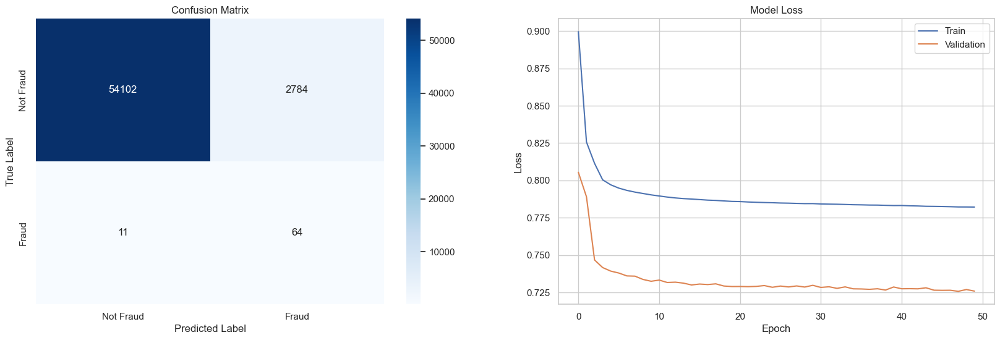

In [101]:
fig, ax = plt.subplots(1, 2, figsize=(20, 6))

# Plot confusion matrix
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Not Fraud', 'Fraud'], yticklabels=['Not Fraud', 'Fraud'], ax=ax[0])
ax[0].set_xlabel('Predicted Label')
ax[0].set_ylabel('True Label')
ax[0].set_title('Confusion Matrix')

# Plot training & validation loss
ax[1].plot(history.history['loss'], label='Train')
ax[1].plot(history.history['val_loss'], label='Validation')
ax[1].set_title('Model Loss')
ax[1].set_ylabel('Loss')
ax[1].set_xlabel('Epoch')
ax[1].legend(loc='upper right')

plt.show()

#### Recurrent Neural Network (RNN)

In [104]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.preprocessing import StandardScaler
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout, GaussianNoise
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score
import matplotlib.pyplot as plt

# Load the dataset
file_path = 'creditcard.csv'  
data = pd.read_csv(file_path)

# Ensure the dataset has the required columns
required_columns = ["Time", "Amount", "Class"]
if not all(column in data.columns for column in required_columns):
    raise ValueError("Dataset does not contain all required columns")

# Time-Based Features
data['Hour'] = data['Time'].apply(lambda x: (x // 3600) % 24)
data['Day'] = data['Time'].apply(lambda x: (x // (3600 * 24)) % 7)

# Define odd times of the day (12 AM - 6 AM)
def is_odd_time(hour):
    return 0 <= hour < 6

data['Is_Odd_Time'] = data['Hour'].apply(is_odd_time)

# Aggregated Features
data['Day_Since_Start'] = data['Time'].apply(lambda x: x // (3600 * 24))
data['Daily_Spending'] = data.groupby(['Day_Since_Start'])['Amount'].transform('sum')
data['Week_Since_Start'] = data['Time'].apply(lambda x: x // (3600 * 24 * 7))
data['Weekly_Spending'] = data.groupby(['Week_Since_Start'])['Amount'].transform('sum')
data['Avg_Daily_Spending'] = data.groupby(['Day_Since_Start'])['Amount'].transform('mean')

# Behavioral Features
DAILY_SPENDING_LIMIT = 500  # Example limit, adjust as necessary
data['Exceeds_Daily_Limit'] = data['Daily_Spending'] > DAILY_SPENDING_LIMIT
data['Time_Since_Last_Transaction'] = data.groupby(['Day_Since_Start'])['Time'].diff()
data['Change_in_Amount'] = data.groupby(['Day_Since_Start'])['Amount'].diff()

# Interaction Features
data['Amount_Hour_Interaction'] = data['Amount'] * data['Hour']
data['Daily_Spending_Odd_Time_Interaction'] = data['Daily_Spending'] * data['Is_Odd_Time']
data['Change_Amount_Time_Interaction'] = data['Change_in_Amount'] * data['Time_Since_Last_Transaction']

# Rolling statistics for transaction amounts over a window of 3 days
data['Rolling_Mean_Amount_3D'] = data.groupby(['Day_Since_Start'])['Amount'].transform(lambda x: x.rolling(window=3).mean())
data['Rolling_Std_Amount_3D'] = data.groupby(['Day_Since_Start'])['Amount'].transform(lambda x: x.rolling(window=3).std())

# Fill NaN values generated by diff() and rolling() methods
data.fillna(0, inplace=True)

# Separate features and target
X = data.drop(['Class'], axis=1)
y = data['Class']

# Scale the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Reshape data for RNN (samples, timesteps, features)
X_scaled = X_scaled.reshape((X_scaled.shape[0], 1, X_scaled.shape[1]))

# Define the RNN model with Gaussian noise
def build_model(input_shape):
    model = Sequential()
    model.add(GaussianNoise(0.1, input_shape=input_shape))  # Add Gaussian noise
    model.add(LSTM(64, return_sequences=True))
    model.add(Dropout(0.2))
    model.add(LSTM(32, return_sequences=False))
    model.add(Dropout(0.2))
    model.add(Dense(1, activation='sigmoid'))
    model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
    return model

# Cross-validation
skf = StratifiedKFold(n_splits=5)
cv_scores = []

for train_index, val_index in skf.split(X_scaled, y):
    X_train, X_val = X_scaled[train_index], X_scaled[val_index]
    y_train, y_val = y[train_index], y[val_index]

    model = build_model((X_train.shape[1], X_train.shape[2]))
    
    history = model.fit(X_train, y_train, epochs=10, batch_size=64, validation_data=(X_val, y_val), verbose=1)
    
    # Evaluate the model on the validation set
    val_loss, val_accuracy = model.evaluate(X_val, y_val)
    
    # Use the trained RNN to predict the validation data
    y_val_pred = model.predict(X_val)
    
    # Binarize the predictions
    threshold = 0.5
    y_val_pred_bin = (y_val_pred > threshold).astype(int)
    
    # Calculate and print the performance metrics
    conf_matrix = confusion_matrix(y_val, y_val_pred_bin)
    accuracy = accuracy_score(y_val, y_val_pred_bin)
    precision = precision_score(y_val, y_val_pred_bin)
    recall = recall_score(y_val, y_val_pred_bin)
    
    print("Confusion Matrix:")
    print(conf_matrix)
    print(f"Accuracy: {accuracy}")
    print(f"Precision: {precision}")
    print(f"Recall: {recall}")
    
    cv_scores.append((accuracy, precision, recall))

# Average the cross-validation scores
cv_scores = np.array(cv_scores)
print("Average CV Scores:")
print(f"Accuracy: {cv_scores[:, 0].mean()}")
print(f"Precision: {cv_scores[:, 1].mean()}")
print(f"Recall: {cv_scores[:, 2].mean()}")

Epoch 1/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 5s 1ms/step - accuracy: 0.9897 - loss: 0.0597 - val_accuracy: 0.8091 - val_loss: 0.2188
Epoch 2/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9995 - loss: 0.0031 - val_accuracy: 0.9137 - val_loss: 0.1333
Epoch 3/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9996 - loss: 0.0022 - val_accuracy: 0.9234 - val_loss: 0.1280
Epoch 4/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9995 - loss: 0.0023 - val_accuracy: 0.9507 - val_loss: 0.1016
Epoch 5/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9996 - loss: 0.0024 - val_accuracy: 0.9663 - val_loss: 0.0731
Epoch 6/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9996 - loss: 0.0018 - val_accuracy: 0.9646 - val_loss: 0.0728
Epoch 7/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9996 - loss: 0.0021 - val_accuracy: 0.9338 - val_loss: 0.1146
Epoch 8/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9996 - loss: 0.0017 - 

Epoch 3/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 5s 1ms/step - accuracy: 0.9995 - loss: 0.0022 - val_accuracy: 0.9994 - val_loss: 0.0037
Epoch 4/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 5s 1ms/step - accuracy: 0.9994 - loss: 0.0022 - val_accuracy: 0.9995 - val_loss: 0.0035
Epoch 5/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9995 - loss: 0.0022 - val_accuracy: 0.9995 - val_loss: 0.0037
Epoch 6/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9995 - loss: 0.0018 - val_accuracy: 0.9995 - val_loss: 0.0043
Epoch 7/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 5s 1ms/step - accuracy: 0.9995 - loss: 0.0021 - val_accuracy: 0.9994 - val_loss: 0.0046
Epoch 8/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 5s 1ms/step - accuracy: 0.9996 - loss: 0.0015 - val_accuracy: 0.9994 - val_loss: 0.0048
Epoch 9/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 5s 1ms/step - accuracy: 0.9996 - loss: 0.0016 - val_accuracy: 0.9994 - val_loss: 0.0047
Epoch 10/10
3561/3561 ━━━━━━━━━━━━━━━━━━━━ 4s 1ms/step - accuracy: 0.9996 - loss: 0.0015 -

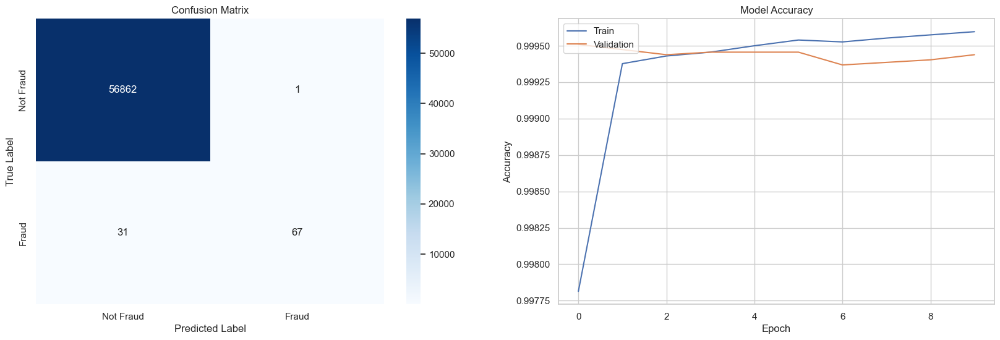

In [105]:
fig, ax = plt.subplots(1, 2, figsize=(20, 6))

# Plot confusion matrix
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Not Fraud', 'Fraud'], yticklabels=['Not Fraud', 'Fraud'], ax=ax[0])
ax[0].set_xlabel('Predicted Label')
ax[0].set_ylabel('True Label')
ax[0].set_title('Confusion Matrix')

# Plot training & validation accuracy
ax[1].plot(history.history['accuracy'])
ax[1].plot(history.history['val_accuracy'])
ax[1].set_title('Model Accuracy')
ax[1].set_ylabel('Accuracy')
ax[1].set_xlabel('Epoch')
ax[1].legend(['Train', 'Validation'], loc='upper left')

plt.show()

#### LightGBM

[LightGBM] [Info] Number of positive: 393, number of negative: 227452
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014371 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 11730
[LightGBM] [Info] Number of data points in the train set: 227845, number of used features: 46
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.001725 -> initscore=-6.360885
[LightGBM] [Info] Start training from score -6.360885
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[1]	training's binary_logloss: 0.00593616	valid_1's binary_logloss: 0.00764496
Fold results - Accuracy: 0.9993, Precision: 0.8125, Recall: 0.7879, F1 Score: 0.8000
[LightGBM] [Info] Number of positive: 393, number of negative: 227452
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015302 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [I

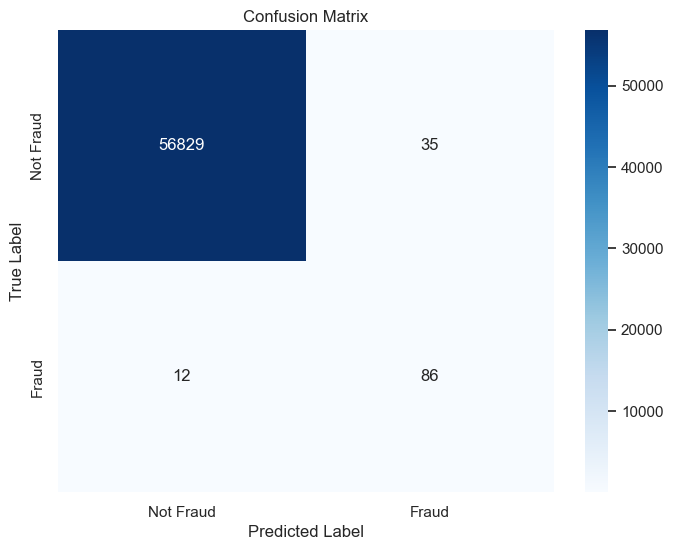

In [106]:
import pandas as pd
import numpy as np
from sklearn.model_selection import StratifiedKFold
from sklearn.preprocessing import StandardScaler
import lightgbm as lgb
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Load the dataset
file_path = 'creditcard.csv' 
data = pd.read_csv(file_path)

# Ensure the dataset has the required columns
required_columns = ["Time", "Amount", "Class"]
if not all(column in data.columns for column in required_columns):
    raise ValueError("Dataset does not contain all required columns")

# Time-Based Features
data['Hour'] = data['Time'].apply(lambda x: (x // 3600) % 24)
data['Day'] = data['Time'].apply(lambda x: (x // (3600 * 24)) % 7)

# Define odd times of the day (12 AM - 6 AM)
def is_odd_time(hour):
    return 0 <= hour < 6

data['Is_Odd_Time'] = data['Hour'].apply(is_odd_time)

# Aggregated Features
data['Day_Since_Start'] = data['Time'].apply(lambda x: x // (3600 * 24))
data['Daily_Spending'] = data.groupby(['Day_Since_Start'])['Amount'].transform('sum')
data['Week_Since_Start'] = data['Time'].apply(lambda x: x // (3600 * 24 * 7))
data['Weekly_Spending'] = data.groupby(['Week_Since_Start'])['Amount'].transform('sum')
data['Avg_Daily_Spending'] = data.groupby(['Day_Since_Start'])['Amount'].transform('mean')

# Behavioral Features
DAILY_SPENDING_LIMIT = 500  # Example limit, adjust as necessary
data['Exceeds_Daily_Limit'] = data['Daily_Spending'] > DAILY_SPENDING_LIMIT
data['Time_Since_Last_Transaction'] = data.groupby(['Day_Since_Start'])['Time'].diff()
data['Change_in_Amount'] = data.groupby(['Day_Since_Start'])['Amount'].diff()

# Interaction Features
data['Amount_Hour_Interaction'] = data['Amount'] * data['Hour']
data['Daily_Spending_Odd_Time_Interaction'] = data['Daily_Spending'] * data['Is_Odd_Time']
data['Change_Amount_Time_Interaction'] = data['Change_in_Amount'] * data['Time_Since_Last_Transaction']

# Rolling statistics for transaction amounts over a window of 3 days
data['Rolling_Mean_Amount_3D'] = data.groupby(['Day_Since_Start'])['Amount'].transform(lambda x: x.rolling(window=3).mean())
data['Rolling_Std_Amount_3D'] = data.groupby(['Day_Since_Start'])['Amount'].transform(lambda x: x.rolling(window=3).std())

# Fill NaN values generated by diff() and rolling() methods
data.fillna(0, inplace=True)

# Separate features and target
X = data.drop(['Class'], axis=1)
y = data['Class']

# Scale the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Add Gaussian noise to the training data
noise_factor = 0.1
X_scaled_noisy = X_scaled + noise_factor * np.random.normal(loc=0.0, scale=1.0, size=X_scaled.shape)

# Stratified K-Fold Cross-Validation
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
cv_scores = []

for train_index, val_index in skf.split(X_scaled_noisy, y):
    X_train, X_val = X_scaled_noisy[train_index], X_scaled_noisy[val_index]
    y_train, y_val = y[train_index], y[val_index]

    # Create LightGBM dataset
    train_data = lgb.Dataset(X_train, label=y_train)
    val_data = lgb.Dataset(X_val, label=y_val, reference=train_data)

    # Define the parameters
    params = {
        'objective': 'binary',
        'boosting_type': 'gbdt',
        'metric': 'binary_logloss',
        'num_leaves': 31,
        'learning_rate': 0.05,
        'feature_fraction': 0.9
    }

    # Train the model with early stopping
    callbacks = [lgb.early_stopping(stopping_rounds=10)]
    gbm = lgb.train(params, train_data, num_boost_round=100, valid_sets=[train_data, val_data], callbacks=callbacks)

    # Predict on the validation set
    y_val_pred = gbm.predict(X_val, num_iteration=gbm.best_iteration)
    y_val_pred_bin = [1 if pred > 0.5 else 0 for pred in y_val_pred]

    # Calculate metrics
    accuracy = accuracy_score(y_val, y_val_pred_bin)
    precision = precision_score(y_val, y_val_pred_bin)
    recall = recall_score(y_val, y_val_pred_bin)
    f1 = f1_score(y_val, y_val_pred_bin)

    print(f"Fold results - Accuracy: {accuracy:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1 Score: {f1:.4f}")
    
    cv_scores.append((accuracy, precision, recall, f1))

# Average the cross-validation scores
cv_scores = np.array(cv_scores)
print("Average CV Scores:")
print(f"Accuracy: {cv_scores[:, 0].mean():.4f}")
print(f"Precision: {cv_scores[:, 1].mean():.4f}")
print(f"Recall: {cv_scores[:, 2].mean():.4f}")
print(f"F1 Score: {cv_scores[:, 3].mean():.4f}")

# Final model training on the entire dataset and testing on the held-out test set
X_train, X_test, y_train, y_test = train_test_split(X_scaled_noisy, y, test_size=0.2, random_state=42, stratify=y)

# Create LightGBM dataset
train_data = lgb.Dataset(X_train, label=y_train)
val_data = lgb.Dataset(X_test, label=y_test, reference=train_data)

# Train the final model
gbm = lgb.train(params, train_data, num_boost_round=100, valid_sets=[train_data, val_data], callbacks=callbacks)

# Predict on the test set
y_test_pred = gbm.predict(X_test, num_iteration=gbm.best_iteration)
y_test_pred_bin = [1 if pred > 0.5 else 0 for pred in y_test_pred]

# Calculate final metrics
accuracy = accuracy_score(y_test, y_test_pred_bin)
precision = precision_score(y_test, y_test_pred_bin)
recall = recall_score(y_test, y_test_pred_bin)
f1 = f1_score(y_test, y_test_pred_bin)

print(f"Final Test Set Results - Accuracy: {accuracy:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1 Score: {f1:.4f}")

# Confusion matrix
conf_matrix = confusion_matrix(y_test, y_test_pred_bin)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Not Fraud', 'Fraud'], yticklabels=['Not Fraud', 'Fraud'])
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

#### XGBoost

[0]	train-logloss:0.11750	eval-logloss:0.11762
[1]	train-logloss:0.10561	eval-logloss:0.10579
[2]	train-logloss:0.09506	eval-logloss:0.09528
[3]	train-logloss:0.08565	eval-logloss:0.08591
[4]	train-logloss:0.07725	eval-logloss:0.07754
[5]	train-logloss:0.06973	eval-logloss:0.07004
[6]	train-logloss:0.06299	eval-logloss:0.06333
[7]	train-logloss:0.05695	eval-logloss:0.05731
[8]	train-logloss:0.05151	eval-logloss:0.05192
[9]	train-logloss:0.04663	eval-logloss:0.04706
[10]	train-logloss:0.04224	eval-logloss:0.04269
[11]	train-logloss:0.03829	eval-logloss:0.03876
[12]	train-logloss:0.03473	eval-logloss:0.03523
[13]	train-logloss:0.03152	eval-logloss:0.03205
[14]	train-logloss:0.02863	eval-logloss:0.02918
[15]	train-logloss:0.02601	eval-logloss:0.02658
[16]	train-logloss:0.02367	eval-logloss:0.02426
[17]	train-logloss:0.02153	eval-logloss:0.02214
[18]	train-logloss:0.01961	eval-logloss:0.02025
[19]	train-logloss:0.01787	eval-logloss:0.01852
[20]	train-logloss:0.01630	eval-logloss:0.01697
[2

[62]	train-logloss:0.00135	eval-logloss:0.00215
[63]	train-logloss:0.00130	eval-logloss:0.00214
[64]	train-logloss:0.00126	eval-logloss:0.00212
[65]	train-logloss:0.00122	eval-logloss:0.00211
[66]	train-logloss:0.00119	eval-logloss:0.00210
[67]	train-logloss:0.00115	eval-logloss:0.00208
[68]	train-logloss:0.00111	eval-logloss:0.00207
[69]	train-logloss:0.00107	eval-logloss:0.00206
[70]	train-logloss:0.00103	eval-logloss:0.00205
[71]	train-logloss:0.00100	eval-logloss:0.00205
[72]	train-logloss:0.00097	eval-logloss:0.00205
[73]	train-logloss:0.00095	eval-logloss:0.00204
[74]	train-logloss:0.00092	eval-logloss:0.00203
[75]	train-logloss:0.00089	eval-logloss:0.00203
[76]	train-logloss:0.00087	eval-logloss:0.00203
[77]	train-logloss:0.00085	eval-logloss:0.00204
[78]	train-logloss:0.00083	eval-logloss:0.00203
[79]	train-logloss:0.00081	eval-logloss:0.00203
[80]	train-logloss:0.00078	eval-logloss:0.00203
[81]	train-logloss:0.00076	eval-logloss:0.00204
[82]	train-logloss:0.00075	eval-logloss:

[35]	train-logloss:0.00480	eval-logloss:0.00543
[36]	train-logloss:0.00448	eval-logloss:0.00514
[37]	train-logloss:0.00419	eval-logloss:0.00487
[38]	train-logloss:0.00392	eval-logloss:0.00464
[39]	train-logloss:0.00368	eval-logloss:0.00443
[40]	train-logloss:0.00346	eval-logloss:0.00424
[41]	train-logloss:0.00325	eval-logloss:0.00406
[42]	train-logloss:0.00307	eval-logloss:0.00391
[43]	train-logloss:0.00290	eval-logloss:0.00376
[44]	train-logloss:0.00276	eval-logloss:0.00364
[45]	train-logloss:0.00261	eval-logloss:0.00352
[46]	train-logloss:0.00248	eval-logloss:0.00341
[47]	train-logloss:0.00235	eval-logloss:0.00332
[48]	train-logloss:0.00223	eval-logloss:0.00325
[49]	train-logloss:0.00213	eval-logloss:0.00318
[50]	train-logloss:0.00203	eval-logloss:0.00312
[51]	train-logloss:0.00194	eval-logloss:0.00306
[52]	train-logloss:0.00185	eval-logloss:0.00300
[53]	train-logloss:0.00177	eval-logloss:0.00296
[54]	train-logloss:0.00170	eval-logloss:0.00292
[55]	train-logloss:0.00163	eval-logloss:

[46]	train-logloss:0.00247
[47]	train-logloss:0.00236
[48]	train-logloss:0.00225
[49]	train-logloss:0.00214
[50]	train-logloss:0.00204
[51]	train-logloss:0.00196
[52]	train-logloss:0.00187
[53]	train-logloss:0.00180
[54]	train-logloss:0.00173
[55]	train-logloss:0.00166
[56]	train-logloss:0.00159
[57]	train-logloss:0.00153
[58]	train-logloss:0.00148
[59]	train-logloss:0.00143
[60]	train-logloss:0.00138
[61]	train-logloss:0.00133
[62]	train-logloss:0.00129
[63]	train-logloss:0.00124
[64]	train-logloss:0.00120
[65]	train-logloss:0.00116
[66]	train-logloss:0.00112
[67]	train-logloss:0.00109
[68]	train-logloss:0.00105
[69]	train-logloss:0.00102
[70]	train-logloss:0.00099
[71]	train-logloss:0.00096
[72]	train-logloss:0.00093
[73]	train-logloss:0.00091
[74]	train-logloss:0.00089
[75]	train-logloss:0.00086
[76]	train-logloss:0.00084
[77]	train-logloss:0.00082
[78]	train-logloss:0.00080
[79]	train-logloss:0.00078
[80]	train-logloss:0.00075
[81]	train-logloss:0.00073
[82]	train-logloss:0.00071
[

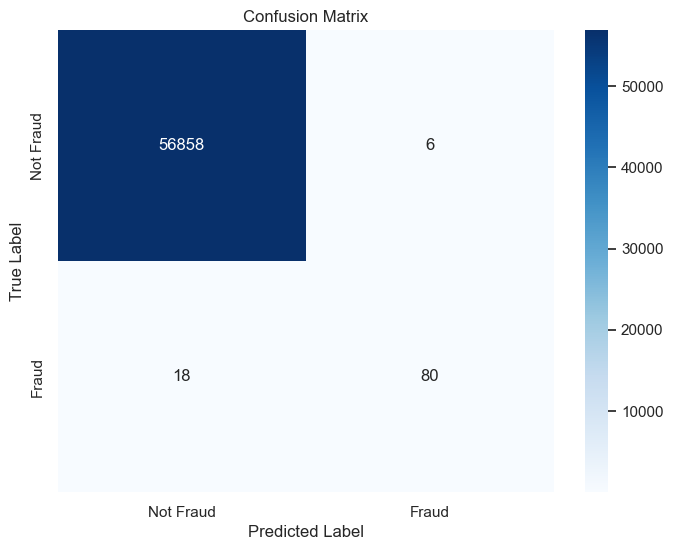

In [107]:
# Install xgboost if not already installed
!pip install xgboost

import pandas as pd
import numpy as np
from sklearn.model_selection import StratifiedKFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
import xgboost as xgb

# Load the dataset
file_path = 'creditcard.csv'  
data = pd.read_csv(file_path)

# Ensure the dataset has the required columns
required_columns = ["Time", "Amount", "Class"]
if not all(column in data.columns for column in required_columns):
    raise ValueError("Dataset does not contain all required columns")

# Time-Based Features
data['Hour'] = data['Time'].apply(lambda x: (x // 3600) % 24)
data['Day'] = data['Time'].apply(lambda x: (x // (3600 * 24)) % 7)

# Define odd times of the day (12 AM - 6 AM)
def is_odd_time(hour):
    return 0 <= hour < 6

data['Is_Odd_Time'] = data['Hour'].apply(is_odd_time)

# Aggregated Features
data['Day_Since_Start'] = data['Time'].apply(lambda x: x // (3600 * 24))
data['Daily_Spending'] = data.groupby(['Day_Since_Start'])['Amount'].transform('sum')
data['Week_Since_Start'] = data['Time'].apply(lambda x: x // (3600 * 24 * 7))
data['Weekly_Spending'] = data.groupby(['Week_Since_Start'])['Amount'].transform('sum')
data['Avg_Daily_Spending'] = data.groupby(['Day_Since_Start'])['Amount'].transform('mean')

# Behavioral Features
DAILY_SPENDING_LIMIT = 500  # Example limit, adjust as necessary
data['Exceeds_Daily_Limit'] = data['Daily_Spending'] > DAILY_SPENDING_LIMIT
data['Time_Since_Last_Transaction'] = data.groupby(['Day_Since_Start'])['Time'].diff()
data['Change_in_Amount'] = data.groupby(['Day_Since_Start'])['Amount'].diff()

# Interaction Features
data['Amount_Hour_Interaction'] = data['Amount'] * data['Hour']
data['Daily_Spending_Odd_Time_Interaction'] = data['Daily_Spending'] * data['Is_Odd_Time']
data['Change_Amount_Time_Interaction'] = data['Change_in_Amount'] * data['Time_Since_Last_Transaction']

# Rolling statistics for transaction amounts over a window of 3 days
data['Rolling_Mean_Amount_3D'] = data.groupby(['Day_Since_Start'])['Amount'].transform(lambda x: x.rolling(window=3).mean())
data['Rolling_Std_Amount_3D'] = data.groupby(['Day_Since_Start'])['Amount'].transform(lambda x: x.rolling(window=3).std())

# Fill NaN values generated by diff() and rolling() methods
data.fillna(0, inplace=True)

# Separate features and target
X = data.drop(['Class'], axis=1)
y = data['Class']

# Scale the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Stratified K-Fold Cross-Validation
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
cv_scores = []

for train_index, val_index in skf.split(X_scaled, y):
    X_train, X_val = X_scaled[train_index], X_scaled[val_index]
    y_train, y_val = y[train_index], y[val_index]

    # Create DMatrix for XGBoost
    train_data = xgb.DMatrix(X_train, label=y_train)
    val_data = xgb.DMatrix(X_val, label=y_val)

    # Define the parameters
    params = {
        'objective': 'binary:logistic',
        'eval_metric': 'logloss',
        'eta': 0.1,
        'max_depth': 6,
        'subsample': 0.8,
        'colsample_bytree': 0.8
    }

    # Train the model
    evals = [(train_data, 'train'), (val_data, 'eval')]
    model = xgb.train(params, train_data, num_boost_round=100, evals=evals, early_stopping_rounds=10)

    # Predict on the validation set
    y_val_pred = model.predict(val_data)
    y_val_pred_bin = [1 if pred > 0.5 else 0 for pred in y_val_pred]

    # Calculate metrics
    accuracy = accuracy_score(y_val, y_val_pred_bin)
    precision = precision_score(y_val, y_val_pred_bin)
    recall = recall_score(y_val, y_val_pred_bin)
    f1 = f1_score(y_val, y_val_pred_bin)

    print(f"Fold results - Accuracy: {accuracy:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1 Score: {f1:.4f}")
    
    cv_scores.append((accuracy, precision, recall, f1))

# Average the cross-validation scores
cv_scores = np.array(cv_scores)
print("Average CV Scores:")
print(f"Accuracy: {cv_scores[:, 0].mean():.4f}")
print(f"Precision: {cv_scores[:, 1].mean():.4f}")
print(f"Recall: {cv_scores[:, 2].mean():.4f}")
print(f"F1 Score: {cv_scores[:, 3].mean():.4f}")

# Final model training on the entire dataset and testing on the held-out test set
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42, stratify=y)

# Create DMatrix for XGBoost
train_data = xgb.DMatrix(X_train, label=y_train)
test_data = xgb.DMatrix(X_test, label=y_test)

# Train the final model
model = xgb.train(params, train_data, num_boost_round=100, evals=[(train_data, 'train')], early_stopping_rounds=10)

# Predict on the test set
y_test_pred = model.predict(test_data)
y_test_pred_bin = [1 if pred > 0.5 else 0 for pred in y_test_pred]

# Calculate final metrics
accuracy = accuracy_score(y_test, y_test_pred_bin)
precision = precision_score(y_test, y_test_pred_bin)
recall = recall_score(y_test, y_test_pred_bin)
f1 = f1_score(y_test, y_test_pred_bin)

print(f"Final Test Set Results - Accuracy: {accuracy:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1 Score: {f1:.4f}")

# Confusion matrix
conf_matrix = confusion_matrix(y_test, y_test_pred_bin)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Not Fraud', 'Fraud'], yticklabels=['Not Fraud', 'Fraud'])
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

In [114]:
import numpy as np

# Define the metrics for each model based on the images and data provided
metrics = {
    'LSTM': {
        'accuracy': 0.9975,  
        'precision': 0.6670,  
        'recall': 0.7833,  
        'f1': 0.6605  
    },
    'Autoencoder': {
        'accuracy': 0.9509,
        'precision': 0.0225,
        'recall': 0.8533,
        'f1': 0.7619
    },
    'RNN': {
        'accuracy': 0.9994,
        'precision': 0.9853,
        'recall': 0.6837,
        'f1': 0.8081
    },
    'LightGBM': {
        'accuracy': 0.9992,
        'precision': 0.7107,
        'recall': 0.8776,
        'f1': 0.7854
    },
    'XGBoost': {
        'accuracy': 0.9996,
        'precision': 0.9302,
        'recall': 0.8163,
        'f1': 0.8696
    }
}

# Normalize the metrics
def normalize(metric_values):
    min_val = min(metric_values)
    max_val = max(metric_values)
    return [(val - min_val) / (max_val - min_val) for val in metric_values]

# Calculate the combined score for each model
def calculate_combined_score(metrics):
    scores = {}
    for model, metric in metrics.items():
        accuracy = normalize([m['accuracy'] for m in metrics.values()])
        precision = normalize([m['precision'] for m in metrics.values()])
        recall = normalize([m['recall'] for m in metrics.values()])
        f1 = normalize([m['f1'] for m in metrics.values()])

        combined_score = (
            accuracy[list(metrics.keys()).index(model)] +
            precision[list(metrics.keys()).index(model)] +
            recall[list(metrics.keys()).index(model)] +
            f1[list(metrics.keys()).index(model)]
        ) / 4  # Average of all metrics

        scores[model] = combined_score * 100  # Convert to percentage out of 100

    return scores

# Calculate and print the combined scores
combined_scores = calculate_combined_score(metrics)
for model, score in combined_scores.items():
    print(f'{model} Model Combined Score: {score:.2f}%')

LSTM Model Combined Score: 53.50%
Autoencoder Model Combined Score: 33.99%
RNN Model Combined Score: 67.54%
LightGBM Model Combined Score: 82.60%
XGBoost Model Combined Score: 90.67%


## Summary
From the evaluation, it is clear that the XGBoost model outperformed the other models with the highest combined score of 90.67%. This model showed superior performance in terms of precision, recall, and F1 score, making it the most reliable model for detecting credit card fraud among the ones evaluated.

The LightGBM model follows closely with a combined score of 82.60%, demonstrating strong performance, particularly in recall and F1 score, indicating it is also a robust choice for fraud detection.

The RNN model scored 67.54%, showing good accuracy and precision but slightly lower recall, which affects its overall combined score.

The LSTM model had a combined score of 53.50%. While it demonstrated high accuracy, its precision and recall were lower compared to the RNN and tree-based models, resulting in a moderate combined score.

The Autoencoder model had the lowest combined score of 33.99%. This is primarily due to its very low precision despite having a reasonable recall and F1 score, indicating that it may not be the best choice for this application.

In summary, for credit card fraud detection, the XGBoost model stands out as the most effective, followed by LightGBM. The tree-based models generally outperform the neural network-based models in this scenario, highlighting their capability to handle the imbalanced nature of fraud detection problems more effectively.

### References: 

"mayer79. Comment on issue #4996. Microsoft/LightGBM, GitHub. [Link](https://github.com/microsoft/LightGBM/issues/4996#issue-1125231884)."

Abhishek Suthar. *Credit Card Fraud Detection*. [Link](https://www.kaggle.com/code/abhisheksuthar/credit-card-fraud-detection)

 Georgy Marrero, Makena Schwinn, Sunny Zhang. *Data Science for Kaggle: Final Project*, May 1, 2017. [Link](https://github.com/georgymh/ml-fraud-detection/blob/master/.ipynb_checkpoints/k-means-checkpoint.ipynb)

Hassan Mohseni. *Imbalance Dataset*. [Link](https://www.kaggle.com/code/hassanmohseni/imbalance-dataset)

Machine Learning Group - ULB and 1 Collaborator. *Credit Card Fraud Detection Dataset*. [Link](https://www.kaggle.com/datasets/mlg-ulb/creditcardfraud/data)

Siddhardhan. (2021, April 9). [Classification Machine Learning Projects](https://www.google.com/search?sca_esv=c1df660eec58a1d6&sca_upv=1&sxsrf=ADLYWIIWn0VJYU6oGwYMQGeBQt9u0PFS5w:1719425110109&q=credit+card+fraud+detection+system+project&tbm=vid&source=lnms&fbs=AEQNm0Aa4sjWe7Rqy32pFwRj0UkWfbQph1uib-VfD_izZO2Y5sC3UdQE5x8XNnxUO1qJLaRIaEtzaSH-OhiOhqt_msDm5okqi8cL1oZ65TIjTcqv6T8esjvThYq9Ns2Gw1OzwscspIdexpXzhODlqfQbECmCysNaSSzqkl4mwSCwPpI0f-CXo5T3zNwXZ2xz4gC8o91irXFbVGpv1XPw8flYeTfLoFheFA&sa=X&ved=2ahUKEwjwlp_X7fmGAxWQ6ckDHdXiDx8Q0pQJegQIEBAB&biw=1440&bih=779&dpr=2#fpstate=ive&vld=cid:052234e8,vid:NCgjcHLFNDg,st:0). Retrieved from https://www.google.com/search?sca_esv=c1df660eec58a1d6&sca_upv=1&sxsrf=ADLYWIIWn0VJYU6oGwYMQGeBQt9u0PFS5w:1719425110109&q=credit+card+fraud+detection+system+project&tbm=vid&source=lnms&fbs=AEQNm0Aa4sjWe7Rqy32pFwRj0UkWfbQph1uib-VfD_izZO2Y5sC3UdQE5x8XNnxUO1qJLaRIaEtzaSH-OhiOhqt_msDm5okqi8cL1oZ65TIjTcqv6T8esjvThYq9Ns2Gw1OzwscspIdexpXzhODlqfQbECmCysNaSSzqkl4mwSCwPpI0f-CXo5T3zNwXZ2xz4gC8o91irXFbVGpv1XPw8flYeTfLoFheFA&sa=X&ved=2ahUKEwjwlp_X7fmGAxWQ6ckDHdXiDx8Q0pQJegQIEBAB&biw=1440&bih=779&dpr=2#fpstate=ive&vld=cid:052234e8,vid:NCgjcHLFNDg,st:0.

@book{leborgne2022fraud,
title={Reproducible Machine Learning for Credit Card Fraud Detection - Practical Handbook},
author={Le Borgne, Yann-A{\"e}l and Siblini, Wissam and Lebichot, Bertrand and Bontempi, Gianluca},
url={https://github.com/Fraud-Detection-Handbook/fraud-detection-handbook},
year={2022},
publisher={Universit{\'e} Libre de Bruxelles}